In [1]:
import pandas as pd
from pathlib import Path
import inspect 

import datetime
import os
import shutil
import json
import matplotlib.pyplot as plt
from torch.utils.tensorboard import SummaryWriter
from matplotlib.ticker import MaxNLocator

from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor

import pickle
import seaborn as sns
sns.set_theme(style="white", rc={"axes.grid": False})


from torch.utils.data import DataLoader
from torch.optim.lr_scheduler import ReduceLROnPlateau
from sklearn.metrics import r2_score, mean_absolute_error
from scipy.stats import wasserstein_distance
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

from models.pernn import *
from models.fcnn import *
from models.pinn import *

from dataset import ClimateDataset

from utils import *



In [2]:
reserved = int(torch.cuda.max_memory_reserved() / 1000 / 1000)
gpu_available = torch.cuda.is_available()

print(colored(f"GPU available! {torch.cuda.get_device_name()}. Memory reserved: {reserved}MB", "green") if gpu_available else colored("No GPU. Running on CPU", "red"))

GPU available! NVIDIA GeForce RTX 3060. Memory reserved: 0MB


In [3]:
device = "cuda"

## Research Notes and Progress

**Current Status**
1. Should we do $X_{t0} \rightarrow NEE_{t1}$ instead of current $X_{t0} \rightarrow NEE_{t0}$ and see if we beat RFR at this
2. MSE experiments
3. Architecture experiments

In [4]:
save_dir = Path("Final Experiments Night")

In [5]:
config = DotMap({"flux_model": "night"})

In [6]:
writer = SummaryWriter(save_dir.joinpath("tensorboard"))

## Model Building and Training

### Data

In [7]:
data = pd.read_parquet("../../PIVAE/PI-VAE-Climate/data_manipulation/final_night_data.parquet")

In [8]:
def set_season_tag(df, isnorth = True):
    if isnorth:
        df["season"] = (df['DateTime'].dt.month%12 + 3) // 3 # print(seasons)
    else:
        df["season"] = ((df['DateTime'].dt.month + 6)%12 + 3)//3
    return df, "season"

def extract_time_features(df):
    """
    Extract features from the timestamp for model training.
    
    Parameters:
    data (pd.DataFrame): DataFrame with 'Timestamp' and 'NEE' columns.
    
    Returns:
    pd.DataFrame: DataFrame with extracted features, list: features added to dataframe
    """
    df = df.copy()
    df['hour'] = df['DateTime'].dt.hour
    df['dayofweek'] = df['DateTime'].dt.dayofweek
    df['month'] = df['DateTime'].dt.month
    df['dayofyear'] = df['DateTime'].dt.dayofyear
    return df, ["hour", "dayofweek", "month", "dayofyear"]
    
def split_data(df, test_size=0.2):
    """
    Split data into training and test sets.
    
    Parameters:
    data (pd.DataFrame): DataFrame with 'Timestamp' and 'NEE' columns.
    test_size (float): Proportion of the data to include in the test split.
    
    Returns:
    tuple: Training and test DataFrames.
    """
    train_data, test_data = train_test_split(df, test_size=test_size, shuffle=False)
    return train_data.reset_index(drop=True), test_data.reset_index(drop=True)

def physics_nee(k, T, Tref=10, T0=46.02):
    e0 = k[:, 0]
    rb = k[:, 1]
    exp_term = np.exp(e0 * (1.0 / (Tref - T0) - 1.0 / (T - T0)))
    NEE = rb * exp_term
    return NEE

In [9]:
drivers = np.array(['Ta', 'H', 'Tau', 'LE_strg', 'RH', 'VPD', 'Rg', 'Ustar', 'Tsoil1', 'Tsoil2'])

In [10]:
data, season_feat = set_season_tag(data)
data, time_feat = extract_time_features(data)

In [11]:
data = data[data["dNEE"].notna()].reset_index(drop=True)

In [12]:
data.shape

(21535, 76)

In [13]:
drivers = np.concatenate([drivers, [season_feat], time_feat])

In [14]:
columns_to_check_na = np.concatenate([drivers, ["NEE", "dTa"]])

idx = (np.sum(data[columns_to_check_na].notna(), axis=1) == columns_to_check_na.shape[0])
data = data.loc[idx].reset_index(drop=True)

In [15]:
data["NEE_phy"] = physics_nee(data[["E0", "rb"]].values, data.Ta.values)

### Noise Distribution and Calculating diffusion coefficient $\sigma_{night}$

In [16]:
phy_error = data.NEE - data.NEE_phy
noise_mu = np.mean(phy_error)
noise_std = np.std(phy_error)

### Training Data 

In [17]:
train_data, test_data = split_data(data)

In [18]:
X_train = train_data[drivers]
NEE_train = train_data["NEE_next"]
T_train = train_data["Ta"]
dT_train = train_data["dTa"]
dNEE_train = train_data["dNEE"]
bNEE_train = train_data["NEE"]
K_train = train_data[["E0", "rb"]]

X_test = test_data[drivers]
NEE_test = test_data["NEE_next"]
T_test = test_data["Ta"]
dT_test = test_data["dTa"]
dNEE_test = test_data["dNEE"]
bNEE_test = test_data["NEE"]
K_test = test_data[["E0", "rb"]]


In [19]:
normalizer = StandardScaler()

X_train = normalizer.fit_transform(X_train)
X_test = normalizer.transform(X_test)

In [20]:
with open(save_dir.joinpath("normalizer.pickle"), "wb") as fp:
    pickle.dump(normalizer, fp)

In [21]:
config.data.X = drivers.tolist()
config.data.train_size = X_train.shape[0]
config.data.train_start_date = train_data["DateTime"].iloc[0].ctime()
config.data.train_end_date = train_data["DateTime"].iloc[-1].ctime()
config.data.test_size = X_test.shape[0]
config.data.test_start_date = test_data["DateTime"].iloc[0].ctime()
config.data.test_end_date = test_data["DateTime"].iloc[-1].ctime()


### Model Building

In [22]:
def initialize_weights(layer):
    if isinstance(layer, nn.Linear):
        # Apply He initialization
        nn.init.xavier_uniform_(layer.weight)
        #init.kaiming_normal_(layer.weight, mode='fan_in', nonlinearity='relu')
        init.zeros_(layer.bias)

### Training Setup

In [23]:
def evaluate(gt, preds, exp_save_dir):
    results = DotMap({'mmd': {}, 'wasstn': {}, 'kl': {}, 'mae': {}, 'r2': {}})
    print(colored("Metrics ", "red"))
    for col in gt:
        print(col)
        mmd = compute_mmd(gt[col], preds[col])
        wasstn = wasserstein_distance(gt[col], preds[col])
        kl = compute_kl_divergence(gt[col], preds[col])
        mae = mean_absolute_error(gt[col], preds[col])
        r2 = r2_score(gt[col]
                      , preds[col])
        print(colored(col, "blue"), "\nMMD: {}, Wasstn: {}, KL: {}, MAE: {}, R2: {}".format(mmd, wasstn, kl, mae, r2))
        config.eval.mae[col] = mean_absolute_error(gt[col], preds[col])
        config.eval.r2[col] = r2_score(gt[col], preds[col])
        results.mmd[col] = mmd
        results.wasstn[col] = wasstn
        results.kl[col] = kl
        results.mae[col] = mae
        results.r2[col] = r2
    return results

# PERNN

In [72]:

lr = 1e-3
exp_save_dir = save_dir.joinpath("PERNN")

best_test_loss = float('inf')
best_model_path = Path("PERNN_best_2").joinpath('best_model.pth')

model = PERNN_res(input_dim=X_train.shape[1] + 1, latent_dim=32, encoder_dims=[16, 16], residual_dims=[16, 16, 8], decoder_dims = [16, 16], activation=nn.LeakyReLU)
model.apply(initialize_weights)

model.to(device)

model.load_state_dict(torch.load(best_model_path, weights_only=True))

optimizer = torch.optim.Adam(model.parameters(), lr=lr)

# Assuming X, k, dNEE, dT, and NEE are numpy arrays you have
test_dataset = ClimateDataset(X_test, K_test.values, T_test.values, dNEE_test.values, bNEE_test.values, dT_test.values, NEE_test.values)

# Create a DataLoader instance
test_data_loader = DataLoader(test_dataset, batch_size=256, shuffle=False)  

loss_fn = nn.MSELoss()
loss_name = "MSE" if str(loss_fn) == 'MSELoss()' else "MMD"

num_epochs = 150
patience = 50
scheduler = ReduceLROnPlateau(optimizer, 'min', patience=patience)

trainer = PERNN_Trainer(optimizer, scheduler, writer, device=device)

gt, preds = trainer.predict(model, test_data_loader)
results = evaluate(gt, preds, exp_save_dir)

Metrics 
nee
nee 
MMD: 0.04310551644566962, Wasstn: 0.2653186625265027, KL: 0.0797251448123367, MAE: 0.941123299172458, R2: 0.6893816848563149
bnee
bnee 
MMD: 0.022859259803273274, Wasstn: 0.164140156888711, KL: 0.06717866406619502, MAE: 0.3765280650034689, R2: 0.9736980079584237
E0
E0 
MMD: 0.20674969030194515, Wasstn: 23.296244578425334, KL: 3.7218135743510135, MAE: 32.75649929867192, R2: -0.5178545168168784
rb
rb 
MMD: 0.24052236753217132, Wasstn: 0.6993548981622787, KL: 1.9259112480173088, MAE: 1.0158969653230765, R2: 0.6926598285529731
dtemp
dtemp 
MMD: 0.23985955517018165, Wasstn: 0.19957454824940862, KL: 1.1821707615831005, MAE: 0.20375434603667242, R2: -540.9084612087202
f
f 
MMD: 0.23344631340022914, Wasstn: 0.2556954961287918, KL: 1.7040339550227965, MAE: 0.2745568605284907, R2: -87.0933621970385


In [73]:
model

PERNN_res(
  (encoder): Sequential(
    (0): ResidualBlock(
      (fc): Linear(in_features=16, out_features=16, bias=True)
      (activation): LeakyReLU(negative_slope=0.01)
      (norm): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): ResidualBlock(
      (fc): Linear(in_features=16, out_features=16, bias=True)
      (activation): LeakyReLU(negative_slope=0.01)
      (norm): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (2): Linear(in_features=16, out_features=32, bias=True)
  )
  (residual): Sequential(
    (0): ResidualBlock(
      (fc): Linear(in_features=32, out_features=16, bias=True)
      (activation): LeakyReLU(negative_slope=0.01)
      (norm): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (projection): Linear(in_features=32, out_features=16, bias=True)
    )
    (1): ResidualBlock(
      (fc): Linear(in_features=16, out_features=16, bias=True)
  

In [74]:
345, 216, 196, 77

(345, 216, 196, 77)

In [70]:
groups, counts = np.unique(test_data['daily_group'], return_counts=True)
idx = np.argsort(counts)
groups[idx]

array([133, 134, 338, 339, 355, 358,   2, 398, 407,  10, 382,  35, 377,
       378,  31,  55,  80,  89, 316, 325, 327, 236, 244, 228, 229, 231,
       234, 235,  98, 104, 284, 290, 291, 293, 295,  13,  17, 304, 220,
       221,  18,  24,  25, 301, 280, 283, 167, 269, 271, 273, 113, 118,
       119, 256, 257, 258, 129, 132, 153, 154, 156, 163, 149, 151,  58,
        67, 383, 384, 386,  49, 205, 206,   8, 419,   7,  32,  61,  74,
        75, 366, 368, 389, 353, 341, 209,  83,  88, 243, 245, 310, 328,
       285, 230, 239, 292,  14, 203,  20, 122, 125, 272, 276, 278, 259,
       109, 116,  47, 416, 412, 427,  34, 135, 274, 270, 265, 359, 331,
       130, 200, 312, 184, 282,  50, 210, 254, 314,  46, 296, 162,  22,
       159, 150, 404, 344,  28, 281, 371,  44, 387, 365, 147, 128,  84,
       329, 313, 173, 218, 330, 224, 158, 155,  95, 364, 238, 286, 400,
       347, 425, 346, 414, 422, 418, 124, 226, 294, 393,  21,  90,  81,
       249,  53, 185, 182, 370, 367,  39, 397, 352,  23, 140, 36

/tmp/ipykernel_132282/2605311833.py:17: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "go-" (-> color='g'). The keyword argument will take precedence.
  ax.plot(gt_vis, 'go-', color="#1f77b4", linewidth=4, markersize=8)
/tmp/ipykernel_132282/2605311833.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "go-" (-> color='g'). The keyword argument will take precedence.
  ax.plot(preds_vis, 'go-', color="#ff7f0e", linewidth=4, markersize=8)


2019-03-10
2019-03-10


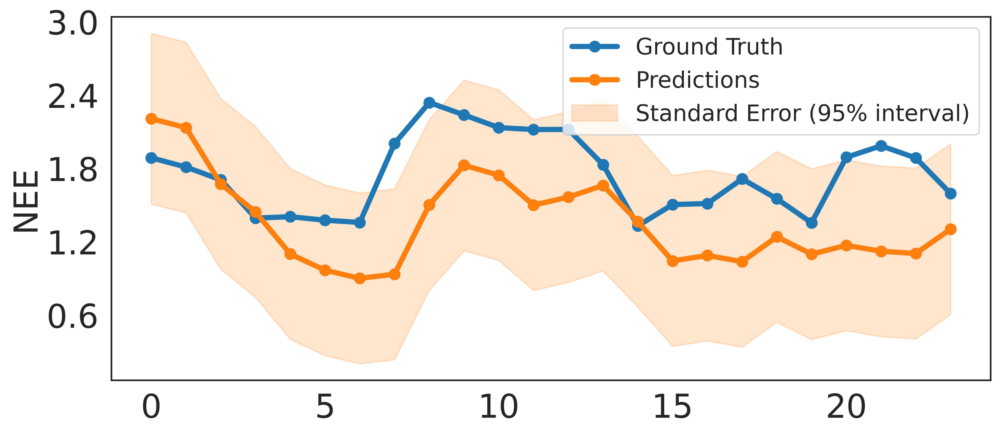

In [90]:
### Daily

test_data['time_diff'] = test_data.DateTime.diff()

test_data['daily_group'] = (test_data.time_diff > pd.Timedelta(hours=2)).cumsum()

mask = (test_data['daily_group'] == 196).values

date = test_data.DateTime[mask].iloc[0]
date = str(date).split(' ')[0]


gt_vis = gt.nee[mask]
preds_vis = preds.nee[mask].flatten()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, 'go-', color="#1f77b4", linewidth=4, markersize=8)
ax.plot(preds_vis, 'go-', color="#ff7f0e", linewidth=4, markersize=8)
ax.set_ylabel(r"NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

residuals = gt_vis - preds_vis
sigma_residual = np.std(residuals, ddof=1)  # ddof=1 for unbiased estimator
z_score = 1.96  # 95% confidence interval
lower_bound = preds_vis - z_score * sigma_residual
upper_bound = preds_vis + z_score * sigma_residual

plt.fill_between(np.arange(len(preds_vis)), lower_bound, upper_bound, color="#ff7f0e", alpha=0.2, label="95% Prediction Interval")
ax.legend(["Ground Truth", "Predictions", "Standard Error (95% interval)"], fontsize='x-large')
print(date)

# ax.set_title(f"PIAE: NEE Daily Scale ({date})", fontsize=30)
print(date)
fig.savefig("piae_nee_night_daily.png", bbox_inches='tight')


2018-09-17 till 2018-09-23


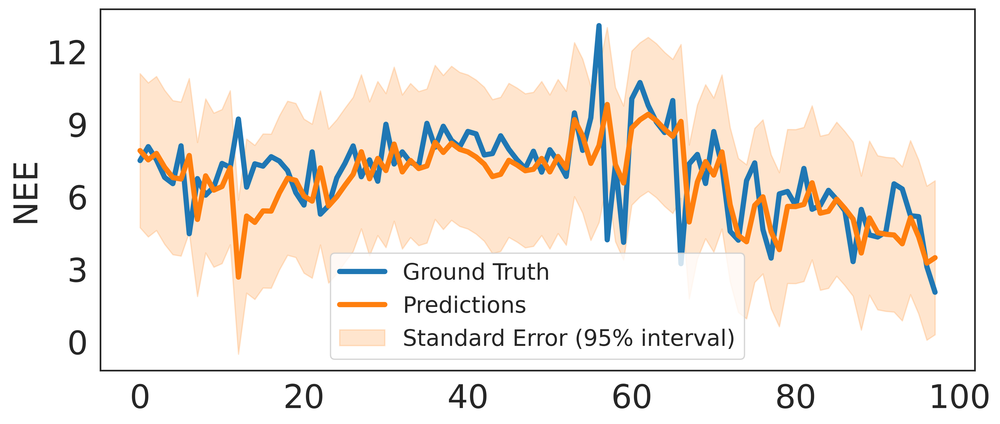

In [91]:
### Weekly

test_data['week_group'] = (test_data['dayofweek'] < test_data['dayofweek'].shift()).cumsum()

mask = test_data.week_group == 5

date1 = test_data.DateTime[mask].iloc[0]
date2 = test_data.DateTime[mask].iloc[-1]
date = str(date1).split(' ')[0] + " till " + str(date2).split(' ')[0]

gt_vis = gt.nee[mask]
preds_vis = preds.nee[mask].flatten()


fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, '-', color="#1f77b4", linewidth=4, markersize=8)
ax.plot(preds_vis, '-', color="#ff7f0e", linewidth=4, markersize=8)

residuals = gt_vis - preds_vis
sigma_residual = np.std(residuals, ddof=1)  # ddof=1 for unbiased estimator
z_score = 1.96  # 95% confidence interval
lower_bound = preds_vis - z_score * sigma_residual
upper_bound = preds_vis + z_score * sigma_residual

plt.fill_between(np.arange(len(preds_vis)), lower_bound, upper_bound, color="#ff7f0e", alpha=0.2, label="95% Prediction Interval")


ax.legend(["Ground Truth", "Predictions", "Standard Error (95% interval)"], fontsize='x-large')
ax.set_ylabel(r"NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

print(date)
# ax.set_title(f"PIAE: NEE Weekly Scale ({date})", fontsize=25)
fig.savefig("piae_nee_night_weekly.png", bbox_inches='tight')


2018-09-01 till 2018-09-30


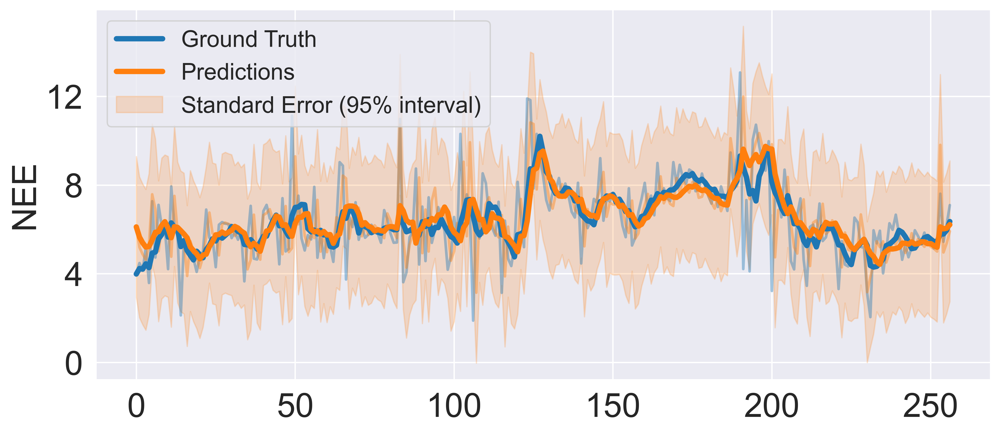

In [106]:
### Monthly

mask = (test_data.DateTime.dt.year == 2018) & (test_data.DateTime.dt.month == 9)

date1 = test_data.DateTime[mask].iloc[0]
date2 = test_data.DateTime[mask].iloc[-1]
date = str(date1).split(' ')[0] + " till " + str(date2).split(' ')[0]

gt_vis = gt.nee[mask]
preds_vis = preds.nee[mask].flatten()

window_size = 5
gt_vis_smoothed = pd.Series(gt_vis).rolling(window=window_size, min_periods=1).mean()
preds_vis_smoothed = pd.Series(preds_vis).rolling(window=window_size, min_periods=1).mean()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, alpha=0.4, color="#1f77b4", linewidth=2)
ax.plot(preds_vis, alpha=0.4, color="#ff7f0e", linewidth=2)
ax.plot(gt_vis_smoothed, color="#1f77b4", label="Ground Truth", linewidth=4)
ax.plot(preds_vis_smoothed, color="#ff7f0e", label="Predictions", linewidth=4)

ax.set_ylabel(r"NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

residuals = gt_vis - preds_vis
sigma_residual = np.std(residuals, ddof=1)  # ddof=1 for unbiased estimator
z_score = 1.96  # 95% confidence interval
lower_bound = preds_vis - z_score * sigma_residual
upper_bound = preds_vis + z_score * sigma_residual

plt.fill_between(np.arange(len(preds_vis)), lower_bound, upper_bound, color="#ff7f0e", alpha=0.2, label="Standard Error (95% interval)")

# ax.set_title(f"PIAE: NEE Monthly Scale ({date})", fontsize=25)
ax.legend(fontsize='x-large')
print(date)
fig.savefig("piae_nee_night_monthly.png", bbox_inches='tight')

2018-09-01 till 2018-11-30


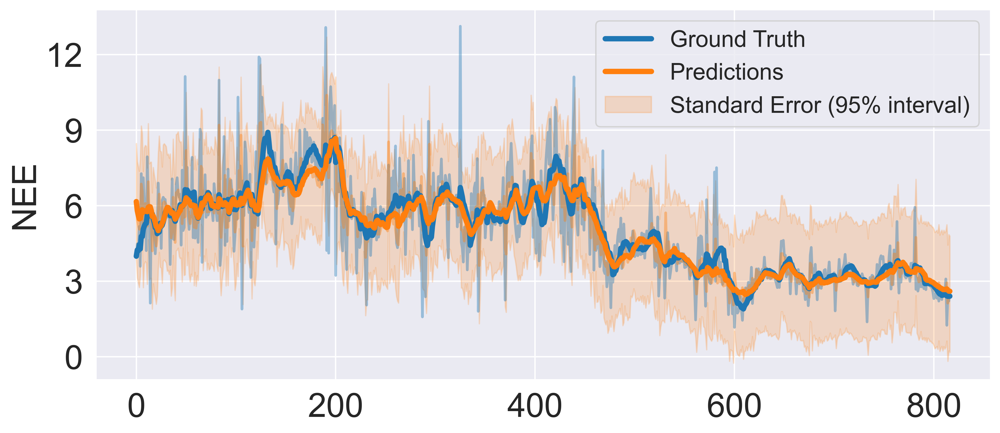

In [141]:
### Quarterly

test_data.season.unique()

mask = (test_data.DateTime.dt.year == 2018) & (test_data.season == 4)

date1 = test_data.DateTime[mask].iloc[0]
date2 = test_data.DateTime[mask].iloc[-1]
date = str(date1).split(' ')[0] + " till " + str(date2).split(' ')[0]

gt_vis = gt.nee[mask]
preds_vis = preds.nee[mask].flatten()

window_size = 10
gt_vis_smoothed = pd.Series(gt_vis).rolling(window=window_size, min_periods=1).mean()
preds_vis_smoothed = pd.Series(preds_vis).rolling(window=window_size, min_periods=1).mean()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, alpha=0.4, color="#1f77b4", linewidth=2)
ax.plot(preds_vis, alpha=0.4, color="#ff7f0e", linewidth=2)
ax.plot(gt_vis_smoothed, color="#1f77b4", label="Ground Truth", linewidth=4)
ax.plot(preds_vis_smoothed, color="#ff7f0e", label="Predictions", linewidth=4)
ax.set_ylabel(r"NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

residuals = gt_vis - preds_vis
sigma_residual = np.std(residuals, ddof=1)  # ddof=1 for unbiased estimator
z_score = 1.96  # 95% confidence interval
lower_bound = preds_vis - z_score * sigma_residual
upper_bound = preds_vis + z_score * sigma_residual

plt.fill_between(np.arange(len(preds_vis)), lower_bound, upper_bound, color="#ff7f0e", alpha=0.2, label="Standard Error (95% interval)")

ax.legend(fontsize='x-large')

print(date)
# ax.set_title(f"PIAE: NEE Quarterly Scale ({date})", fontsize=25)
fig.savefig("piae_nee_night_quarterly.png", bbox_inches='tight')

# PENN

In [62]:

lr = 1e-3
exp_save_dir = save_dir.joinpath("PENN")

best_test_loss = float('inf')
best_model_path = Path("PENN").joinpath('best_model.pth')

model = PENN_res(input_dim=X_train.shape[1] + 1, latent_dim=32, encoder_dims=[16, 16], decoder_dims = [16, 16], activation=nn.LeakyReLU)
model.apply(initialize_weights)

model.to(device)

model.load_state_dict(torch.load(best_model_path, weights_only=True))

optimizer = torch.optim.Adam(model.parameters(), lr=lr)

# Assuming X, k, dNEE, dT, and NEE are numpy arrays you have
test_dataset = ClimateDataset(X_test, K_test.values, T_test.values, dNEE_test.values, bNEE_test.values, dT_test.values, NEE_test.values)

# Create a DataLoader instance
test_data_loader = DataLoader(test_dataset, batch_size=256, shuffle=False)  

loss_fn = nn.MSELoss()
loss_name = "MSE" if str(loss_fn) == 'MSELoss()' else "MMD"

num_epochs = 150
patience = 50
scheduler = ReduceLROnPlateau(optimizer, 'min', patience=patience)

trainer = PERNN_Trainer(optimizer, scheduler, writer, device=device)

gt, preds = trainer.predict(model, test_data_loader)
results = evaluate(gt, preds, exp_save_dir)

Metrics 
nee
nee 
MMD: 0.019153446870759372, Wasstn: 0.09627650959023681, KL: 0.050744750632345556, MAE: 0.9222754909034576, R2: 0.7086135861519878
bnee
bnee 
MMD: 0.022644882519604583, Wasstn: 0.18002527447000688, KL: 0.068473154936041, MAE: 0.4493345518865361, R2: 0.9658823563703766
E0
E0 
MMD: 0.20240941249177216, Wasstn: 21.85208553383501, KL: 4.448404580661218, MAE: 31.59948767758692, R2: -0.41836799599155894
rb
rb 
MMD: 0.11606977990556325, Wasstn: 0.3166644592756728, KL: 1.0235465589441088, MAE: 0.925071893316129, R2: 0.7418185634202481
dtemp
dtemp 
MMD: 0.10747182372126848, Wasstn: 0.12030777126600145, KL: 0.8309945747107198, MAE: 0.128475088811718, R2: -280.50577565263364
f
f 
MMD: 0.12534022202001383, Wasstn: 0.14387083749185586, KL: 0.2819286796769934, MAE: 0.1619517854172084, R2: -42.55521919729797


In [33]:
345, 216, 196, 77

(345, 216, 196, 77)

/tmp/ipykernel_139341/3034732913.py:17: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "go-" (-> color='g'). The keyword argument will take precedence.
  ax.plot(gt_vis, 'go-', color="#1f77b4", linewidth=4, markersize=8)
/tmp/ipykernel_139341/3034732913.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "go-" (-> color='g'). The keyword argument will take precedence.
  ax.plot(preds_vis, 'go-', color="#ff7f0e", linewidth=4, markersize=8)


2019-09-22


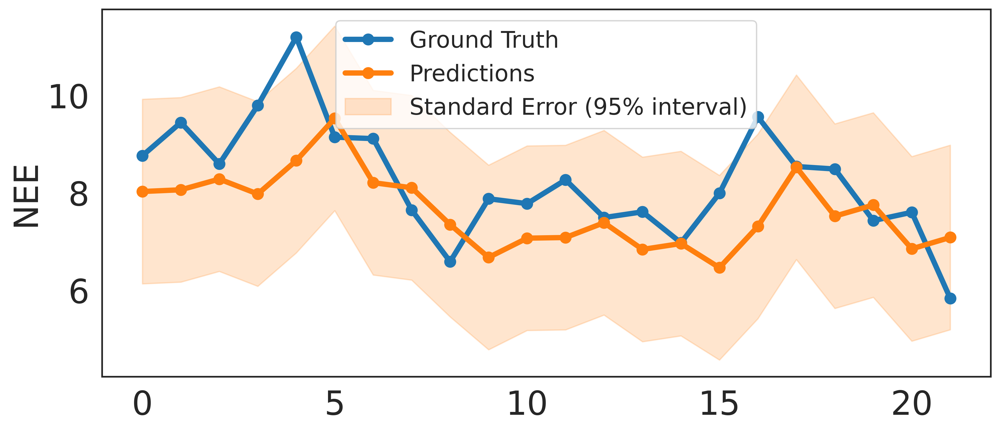

In [40]:
##### Daily

test_data['time_diff'] = test_data.DateTime.diff()

test_data['daily_group'] = (test_data.time_diff > pd.Timedelta(hours=2)).cumsum()

mask = (test_data['daily_group'] == 345).values

date = test_data.DateTime[mask].iloc[0]
date = str(date).split(' ')[0]


gt_vis = gt.nee[mask]
preds_vis = preds.nee[mask].flatten()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, 'go-', color="#1f77b4", linewidth=4, markersize=8)
ax.plot(preds_vis, 'go-', color="#ff7f0e", linewidth=4, markersize=8)
ax.set_ylabel(r"NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

residuals = gt_vis - preds_vis
sigma_residual = np.std(residuals, ddof=1)  # ddof=1 for unbiased estimator
z_score = 1.96  # 95% confidence interval
lower_bound = preds_vis - z_score * sigma_residual
upper_bound = preds_vis + z_score * sigma_residual

plt.fill_between(np.arange(len(preds_vis)), lower_bound, upper_bound, color="#ff7f0e", alpha=0.2, label="95% Prediction Interval")
ax.legend(["Ground Truth", "Predictions", "Standard Error (95% interval)"], fontsize='x-large')

print(date)
# ax.set_title(f"PIAE: NEE Daily Scale ({date})", fontsize=30)
fig.savefig("penn_daily.png", bbox_inches='tight')


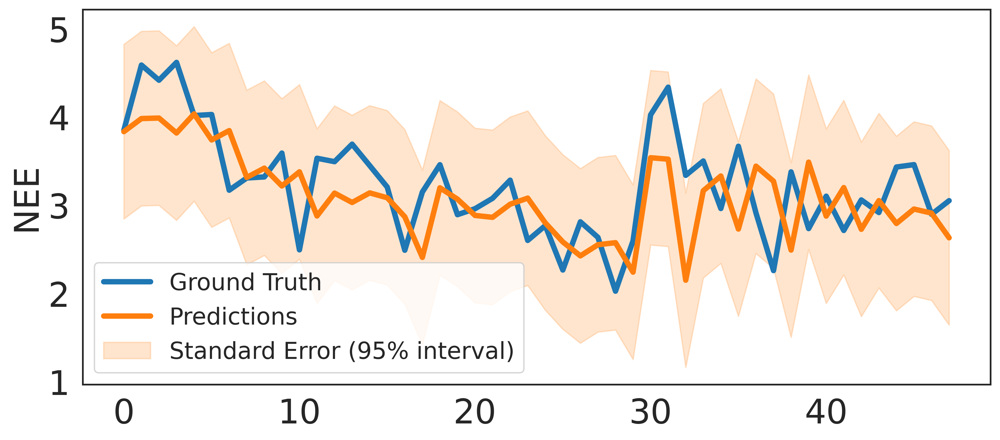

In [65]:
### Weekly

test_data['week_group'] = (test_data['dayofweek'] < test_data['dayofweek'].shift()).cumsum()

mask = test_data.week_group == 12

date1 = test_data.DateTime[mask].iloc[0]
date2 = test_data.DateTime[mask].iloc[-1]
date = str(date1).split(' ')[0] + " till " + str(date2).split(' ')[0]

gt_vis = gt.nee[mask]
preds_vis = preds.nee[mask].flatten()


fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, '-', color="#1f77b4", linewidth=4, markersize=8)
ax.plot(preds_vis, '-', color="#ff7f0e", linewidth=4, markersize=8)

residuals = gt_vis - preds_vis
sigma_residual = np.std(residuals, ddof=1)  # ddof=1 for unbiased estimator
z_score = 1.96  # 95% confidence interval
lower_bound = preds_vis - z_score * sigma_residual
upper_bound = preds_vis + z_score * sigma_residual

plt.fill_between(np.arange(len(preds_vis)), lower_bound, upper_bound, color="#ff7f0e", alpha=0.2, label="95% Prediction Interval")


ax.legend(["Ground Truth", "Predictions", "Standard Error (95% interval)"], fontsize='x-large')
ax.set_ylabel("NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

# ax.set_title(f"PIAE: NEE Weekly Scale ({date})", fontsize=25)
fig.savefig("penn_weekly.png", bbox_inches='tight')


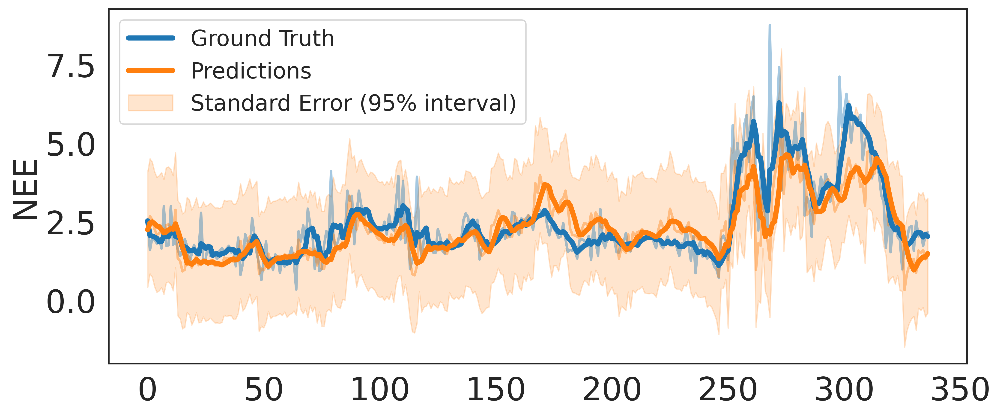

In [66]:
### Monthly

mask = (test_data.DateTime.dt.year == 2019) & (test_data.DateTime.dt.month == 1)

date1 = test_data.DateTime[mask].iloc[0]
date2 = test_data.DateTime[mask].iloc[-1]
date = str(date1).split(' ')[0] + " till " + str(date2).split(' ')[0]

gt_vis = gt.nee[mask]
preds_vis = preds.nee[mask].flatten()

window_size = 5
gt_vis_smoothed = pd.Series(gt_vis).rolling(window=window_size, min_periods=1).mean()
preds_vis_smoothed = pd.Series(preds_vis).rolling(window=window_size, min_periods=1).mean()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, alpha=0.4, color="#1f77b4", linewidth=2)
ax.plot(preds_vis, alpha=0.4, color="#ff7f0e", linewidth=2)
ax.plot(gt_vis_smoothed, color="#1f77b4", label="Ground Truth", linewidth=4)
ax.plot(preds_vis_smoothed, color="#ff7f0e", label="Predictions", linewidth=4)

ax.set_ylabel("NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

residuals = gt_vis - preds_vis
sigma_residual = np.std(residuals, ddof=1)  # ddof=1 for unbiased estimator
z_score = 1.96  # 95% confidence interval
lower_bound = preds_vis - z_score * sigma_residual
upper_bound = preds_vis + z_score * sigma_residual

plt.fill_between(np.arange(len(preds_vis)), lower_bound, upper_bound, color="#ff7f0e", alpha=0.2, label="Standard Error (95% interval)")

# ax.set_title(f"PIAE: NEE Monthly Scale ({date})", fontsize=25)
ax.legend(fontsize='x-large')
fig.savefig("penn_monthly.png", bbox_inches='tight')

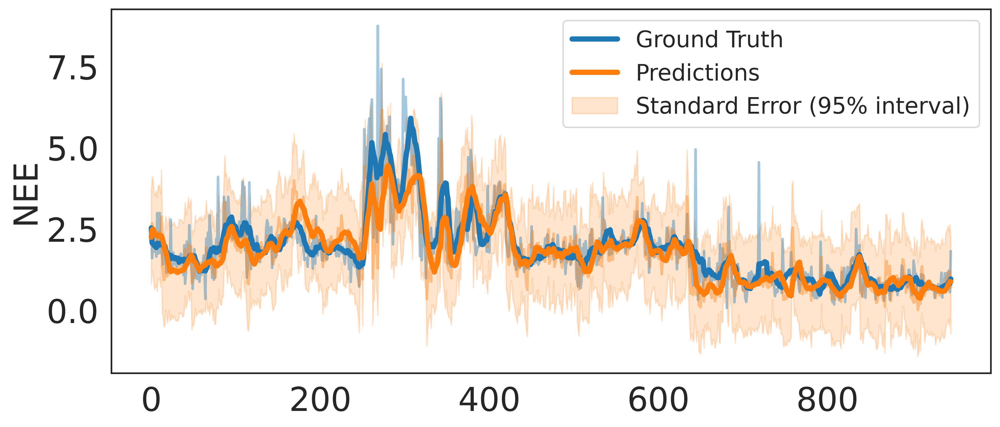

In [68]:
### Quarterly

test_data.season.unique()

mask = (test_data.DateTime.dt.year == 2019) & (test_data.season == 1)

date1 = test_data.DateTime[mask].iloc[0]
date2 = test_data.DateTime[mask].iloc[-1]
date = str(date1).split(' ')[0] + " till " + str(date2).split(' ')[0]

gt_vis = gt.nee[mask]
preds_vis = preds.nee[mask].flatten()

window_size = 10
gt_vis_smoothed = pd.Series(gt_vis).rolling(window=window_size, min_periods=1).mean()
preds_vis_smoothed = pd.Series(preds_vis).rolling(window=window_size, min_periods=1).mean()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, alpha=0.4, color="#1f77b4", linewidth=2)
ax.plot(preds_vis, alpha=0.4, color="#ff7f0e", linewidth=2)
ax.plot(gt_vis_smoothed, color="#1f77b4", label="Ground Truth", linewidth=4)
ax.plot(preds_vis_smoothed, color="#ff7f0e", label="Predictions", linewidth=4)
ax.set_ylabel("NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

residuals = gt_vis - preds_vis
sigma_residual = np.std(residuals, ddof=1)  # ddof=1 for unbiased estimator
z_score = 1.96  # 95% confidence interval
lower_bound = preds_vis - z_score * sigma_residual
upper_bound = preds_vis + z_score * sigma_residual

plt.fill_between(np.arange(len(preds_vis)), lower_bound, upper_bound, color="#ff7f0e", alpha=0.2, label="Standard Error (95% interval)")

ax.legend(fontsize='x-large')


# ax.set_title(f"PIAE: NEE Quarterly Scale ({date})", fontsize=25)
fig.savefig("penn_quarterly.png", bbox_inches='tight')

# PINN

In [69]:

lr = 1e-3
exp_save_dir = save_dir.joinpath("PINN")

best_test_loss = float('inf')
best_model_path = Path("PINN").joinpath('best_model.pth')

model = PINN(input_dim=X_train.shape[1] + 1, latent_dim=32, encoder_dims=[16, 16], decoder_dims = [16, 16], activation=nn.LeakyReLU)
model.apply(initialize_weights)

model.to(device)

model.load_state_dict(torch.load(best_model_path, weights_only=True))

optimizer = torch.optim.Adam(model.parameters(), lr=lr)

# Assuming X, k, dNEE, dT, and NEE are numpy arrays you have
test_dataset = ClimateDataset(X_test, K_test.values, T_test.values, dNEE_test.values, bNEE_test.values, dT_test.values, NEE_test.values)

# Create a DataLoader instance
test_data_loader = DataLoader(test_dataset, batch_size=256, shuffle=False)  

loss_fn = nn.MSELoss()
loss_name = "MSE" if str(loss_fn) == 'MSELoss()' else "MMD"

num_epochs = 150
patience = 50
scheduler = ReduceLROnPlateau(optimizer, 'min', patience=patience)

trainer = PINN_Trainer(optimizer, scheduler, writer, device=device)

gt, preds = trainer.predict(model, test_data_loader)
results = evaluate(gt, preds, exp_save_dir)

Metrics 
nee
nee 
MMD: 0.035192256195104826, Wasstn: 0.14626859599434155, KL: 0.11085087381102772, MAE: 0.9238789383999569, R2: 0.7241502855684567
E0
E0 
MMD: 0.20373853835925104, Wasstn: 24.200302750385063, KL: 4.501487291016884, MAE: 32.8902798765704, R2: -0.5070923822358602
rb
rb 
MMD: 0.23208164765473988, Wasstn: 0.6357324281796443, KL: 2.6960407643890405, MAE: 0.9281015303235209, R2: 0.7466566005909601
dtemp
dtemp 
MMD: 0.08367468080804728, Wasstn: 0.06590476238619691, KL: 0.8758061921970923, MAE: 0.07047891419745786, R2: -66.95756482534806
f
f 
MMD: 0.07663868456323436, Wasstn: 0.06288140573214489, KL: 0.4957469582248399, MAE: 0.07842555854311842, R2: -5.904656753369502


In [43]:
345, 216, 196, 77

(345, 216, 196, 77)

/tmp/ipykernel_139341/2282753650.py:17: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "go-" (-> color='g'). The keyword argument will take precedence.
  ax.plot(gt_vis, 'go-', color="#1f77b4", linewidth=4, markersize=8)
/tmp/ipykernel_139341/2282753650.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "go-" (-> color='g'). The keyword argument will take precedence.
  ax.plot(preds_vis, 'go-', color="#ff7f0e", linewidth=4, markersize=8)


2019-09-22


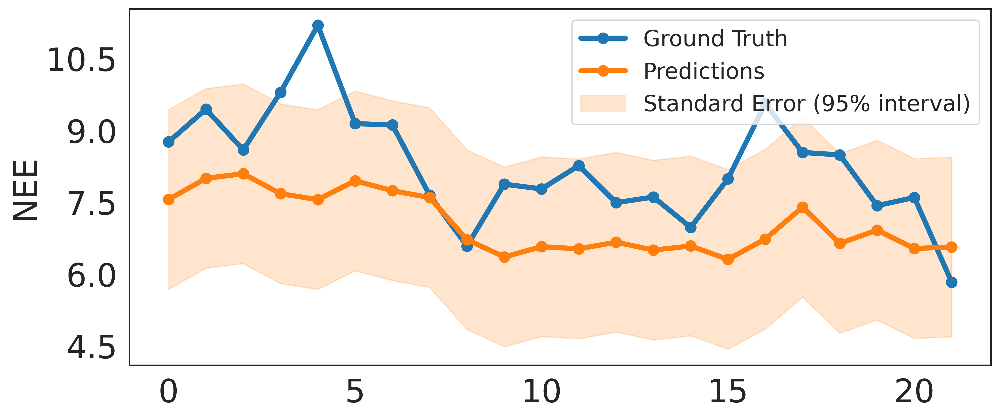

In [70]:
##### Daily

test_data['time_diff'] = test_data.DateTime.diff()

test_data['daily_group'] = (test_data.time_diff > pd.Timedelta(hours=2)).cumsum()

mask = (test_data['daily_group'] == 345).values

date = test_data.DateTime[mask].iloc[0]
date = str(date).split(' ')[0]


gt_vis = gt.nee[mask]
preds_vis = preds.nee[mask].flatten()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, 'go-', color="#1f77b4", linewidth=4, markersize=8)
ax.plot(preds_vis, 'go-', color="#ff7f0e", linewidth=4, markersize=8)
ax.set_ylabel(r"NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

residuals = gt_vis - preds_vis
sigma_residual = np.std(residuals, ddof=1)  # ddof=1 for unbiased estimator
z_score = 1.96  # 95% confidence interval
lower_bound = preds_vis - z_score * sigma_residual
upper_bound = preds_vis + z_score * sigma_residual

plt.fill_between(np.arange(len(preds_vis)), lower_bound, upper_bound, color="#ff7f0e", alpha=0.2, label="95% Prediction Interval")
ax.legend(["Ground Truth", "Predictions", "Standard Error (95% interval)"], fontsize='x-large')

print(date)
# ax.set_title(f"PIAE: NEE Daily Scale ({date})", fontsize=30)
fig.savefig("pinn_daily.png", bbox_inches='tight')


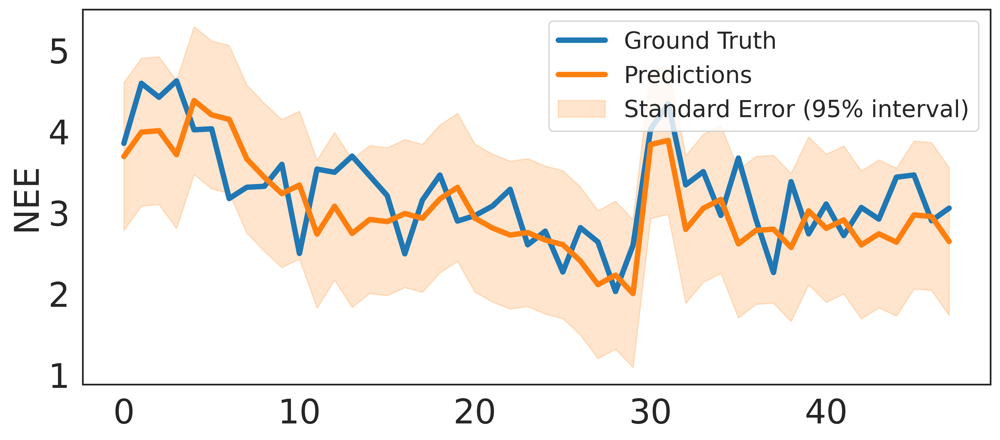

In [71]:
### Weekly

test_data['week_group'] = (test_data['dayofweek'] < test_data['dayofweek'].shift()).cumsum()

mask = test_data.week_group == 12

date1 = test_data.DateTime[mask].iloc[0]
date2 = test_data.DateTime[mask].iloc[-1]
date = str(date1).split(' ')[0] + " till " + str(date2).split(' ')[0]

gt_vis = gt.nee[mask]
preds_vis = preds.nee[mask].flatten()


fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, '-', color="#1f77b4", linewidth=4, markersize=8)
ax.plot(preds_vis, '-', color="#ff7f0e", linewidth=4, markersize=8)

residuals = gt_vis - preds_vis
sigma_residual = np.std(residuals, ddof=1)  # ddof=1 for unbiased estimator
z_score = 1.96  # 95% confidence interval
lower_bound = preds_vis - z_score * sigma_residual
upper_bound = preds_vis + z_score * sigma_residual

plt.fill_between(np.arange(len(preds_vis)), lower_bound, upper_bound, color="#ff7f0e", alpha=0.2, label="95% Prediction Interval")


ax.legend(["Ground Truth", "Predictions", "Standard Error (95% interval)"], fontsize='x-large')
ax.set_ylabel("NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

# ax.set_title(f"PIAE: NEE Weekly Scale ({date})", fontsize=25)
fig.savefig("pinn_weekly.png", bbox_inches='tight')


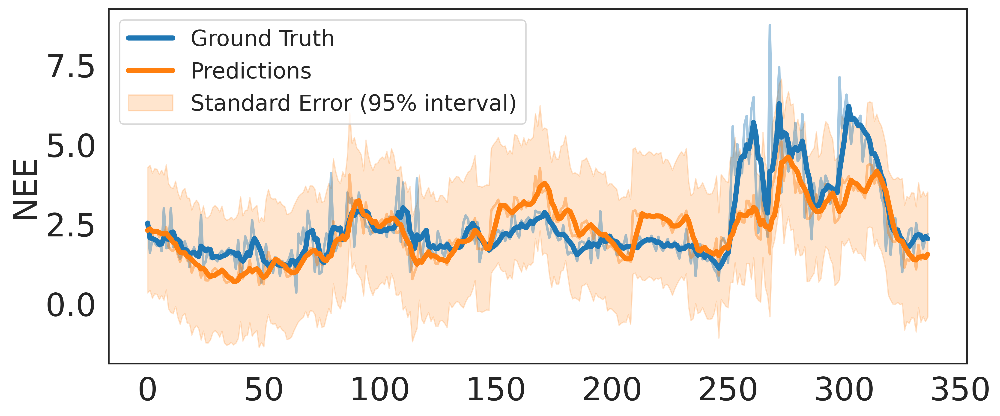

In [72]:
### Monthly

mask = (test_data.DateTime.dt.year == 2019) & (test_data.DateTime.dt.month == 1)

date1 = test_data.DateTime[mask].iloc[0]
date2 = test_data.DateTime[mask].iloc[-1]
date = str(date1).split(' ')[0] + " till " + str(date2).split(' ')[0]

gt_vis = gt.nee[mask]
preds_vis = preds.nee[mask].flatten()

window_size = 5
gt_vis_smoothed = pd.Series(gt_vis).rolling(window=window_size, min_periods=1).mean()
preds_vis_smoothed = pd.Series(preds_vis).rolling(window=window_size, min_periods=1).mean()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, alpha=0.4, color="#1f77b4", linewidth=2)
ax.plot(preds_vis, alpha=0.4, color="#ff7f0e", linewidth=2)
ax.plot(gt_vis_smoothed, color="#1f77b4", label="Ground Truth", linewidth=4)
ax.plot(preds_vis_smoothed, color="#ff7f0e", label="Predictions", linewidth=4)

ax.set_ylabel("NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

residuals = gt_vis - preds_vis
sigma_residual = np.std(residuals, ddof=1)  # ddof=1 for unbiased estimator
z_score = 1.96  # 95% confidence interval
lower_bound = preds_vis - z_score * sigma_residual
upper_bound = preds_vis + z_score * sigma_residual

plt.fill_between(np.arange(len(preds_vis)), lower_bound, upper_bound, color="#ff7f0e", alpha=0.2, label="Standard Error (95% interval)")

# ax.set_title(f"PIAE: NEE Monthly Scale ({date})", fontsize=25)
ax.legend(fontsize='x-large')
fig.savefig("pinn_monthly.png", bbox_inches='tight')

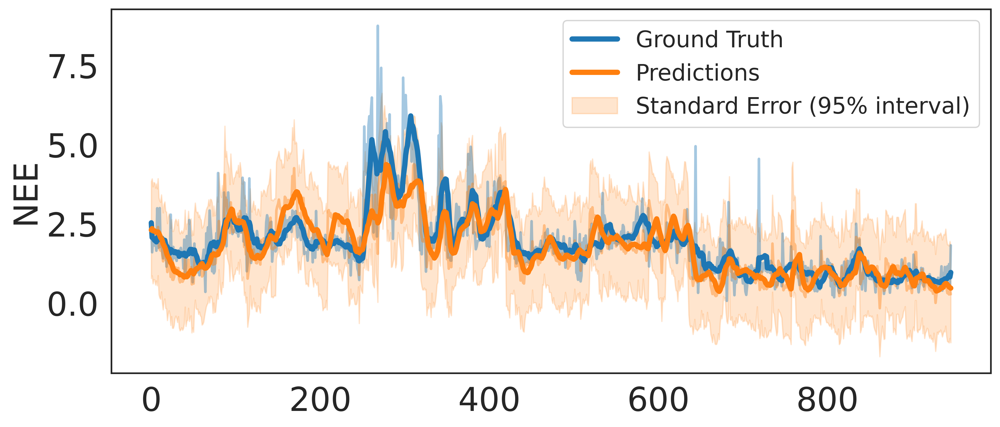

In [73]:
### Quarterly

test_data.season.unique()

mask = (test_data.DateTime.dt.year == 2019) & (test_data.season == 1)

date1 = test_data.DateTime[mask].iloc[0]
date2 = test_data.DateTime[mask].iloc[-1]
date = str(date1).split(' ')[0] + " till " + str(date2).split(' ')[0]

gt_vis = gt.nee[mask]
preds_vis = preds.nee[mask].flatten()

window_size = 10
gt_vis_smoothed = pd.Series(gt_vis).rolling(window=window_size, min_periods=1).mean()
preds_vis_smoothed = pd.Series(preds_vis).rolling(window=window_size, min_periods=1).mean()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, alpha=0.4, color="#1f77b4", linewidth=2)
ax.plot(preds_vis, alpha=0.4, color="#ff7f0e", linewidth=2)
ax.plot(gt_vis_smoothed, color="#1f77b4", label="Ground Truth", linewidth=4)
ax.plot(preds_vis_smoothed, color="#ff7f0e", label="Predictions", linewidth=4)
ax.set_ylabel("NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

residuals = gt_vis - preds_vis
sigma_residual = np.std(residuals, ddof=1)  # ddof=1 for unbiased estimator
z_score = 1.96  # 95% confidence interval
lower_bound = preds_vis - z_score * sigma_residual
upper_bound = preds_vis + z_score * sigma_residual

plt.fill_between(np.arange(len(preds_vis)), lower_bound, upper_bound, color="#ff7f0e", alpha=0.2, label="Standard Error (95% interval)")

ax.legend(fontsize='x-large')


# ax.set_title(f"PIAE: NEE Quarterly Scale ({date})", fontsize=25)
fig.savefig("pinn_quarterly.png", bbox_inches='tight')

# Random Forest

In [74]:
seed = 0

results = DotMap({})
print(f"Experimenting for seed {seed}")
torch.manual_seed(seed)
input_rfr = np.concatenate((X_train, train_data[['NEE']].values), axis=1)  # list(range(0, 15)) + [16, 17]
rfr = RandomForestRegressor(n_estimators=100, random_state=seed, n_jobs=-1)
rfr.fit(input_rfr, NEE_train)
input_rfr = np.concatenate((X_test, test_data[['NEE']].values), axis=1)
preds_rfr = rfr.predict(input_rfr)
gt_rfr = NEE_test.values
mmd = compute_mmd(gt_rfr, preds_rfr)
wasstn = wasserstein_distance(gt_rfr, preds_rfr)
kl = compute_kl_divergence(gt_rfr, preds_rfr)
mae = mean_absolute_error(gt_rfr, preds_rfr)
r2 = r2_score(gt_rfr, preds_rfr)
results.mmd = mmd
results.wasstn = wasstn
results.kl = kl
results.mae = mae
results.r2 = r2
print(colored("NEE", "blue"), "\nMMD: {}, Wasstn: {}, KL: {}, MAE: {}, R2: {}".format(mmd, wasstn, kl, mae, r2))

    

Experimenting for seed 0
NEE 
MMD: 0.05673930420506486, Wasstn: 0.16946047924952207, KL: 0.2465314209840571, MAE: 0.8897168426242827, R2: 0.7227778443859394


/tmp/ipykernel_139341/1781947488.py:17: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "go-" (-> color='g'). The keyword argument will take precedence.
  ax.plot(gt_vis, 'go-', color="#1f77b4", linewidth=4, markersize=8)
/tmp/ipykernel_139341/1781947488.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "go-" (-> color='g'). The keyword argument will take precedence.
  ax.plot(preds_vis, 'go-', color="#ff7f0e", linewidth=4, markersize=8)


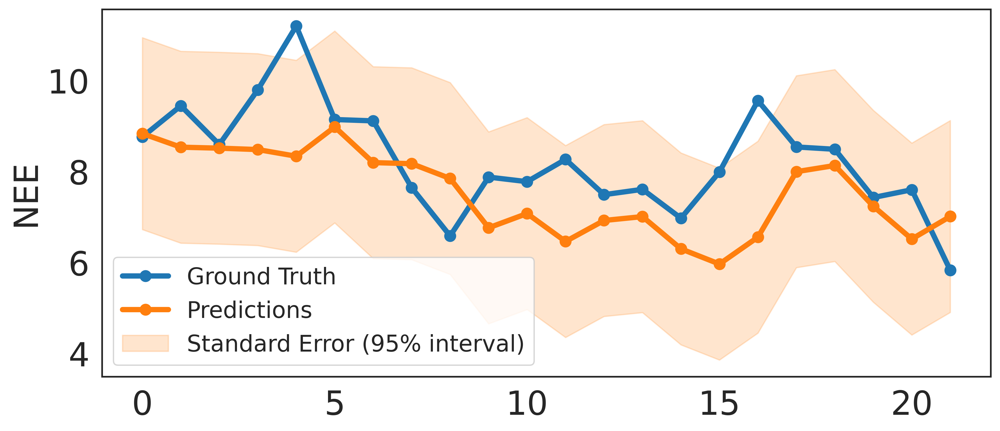

In [75]:
### Daily

test_data['time_diff'] = test_data.DateTime.diff()

test_data['daily_group'] = (test_data.time_diff > pd.Timedelta(hours=2)).cumsum()

mask = (test_data['daily_group'] == 345).values

date = test_data.DateTime[mask].iloc[0]
date = str(date).split(' ')[0]


gt_vis = gt_rfr[mask]
preds_vis = preds_rfr[mask].flatten()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, 'go-', color="#1f77b4", linewidth=4, markersize=8)
ax.plot(preds_vis, 'go-', color="#ff7f0e", linewidth=4, markersize=8)
ax.set_ylabel("NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

residuals = gt_vis - preds_vis
sigma_residual = np.std(residuals, ddof=1)  # ddof=1 for unbiased estimator
z_score = 1.96  # 95% confidence interval
lower_bound = preds_vis - z_score * sigma_residual
upper_bound = preds_vis + z_score * sigma_residual

plt.fill_between(np.arange(len(preds_vis)), lower_bound, upper_bound, color="#ff7f0e", alpha=0.2, label="Standard Error (95% interval)")
ax.legend(["Ground Truth", "Predictions", "Standard Error (95% interval)"], fontsize='x-large')

# ax.set_title(f"RF: NEE Daily Scale ({date})", fontsize=25)
fig.savefig("RF_daily.png", bbox_inches='tight')


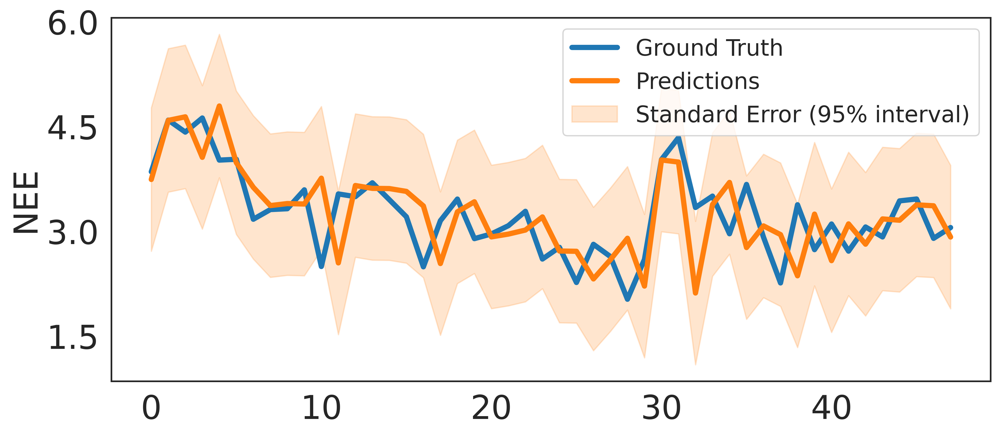

In [76]:
### Weekly

test_data['week_group'] = (test_data['dayofweek'] < test_data['dayofweek'].shift()).cumsum()

mask = test_data.week_group == 12

date1 = test_data.DateTime[mask].iloc[0]
date2 = test_data.DateTime[mask].iloc[-1]
date = str(date1).split(' ')[0] + " till " + str(date2).split(' ')[0]

gt_vis = gt_rfr[mask]
preds_vis = preds_rfr[mask].flatten()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, '-', color="#1f77b4", linewidth=4, markersize=8)
ax.plot(preds_vis, '-', color="#ff7f0e", linewidth=4, markersize=8)
ax.set_ylabel("NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

residuals = gt_vis - preds_vis
sigma_residual = np.std(residuals, ddof=1)  # ddof=1 for unbiased estimator
z_score = 1.96  # 95% confidence interval
lower_bound = preds_vis - z_score * sigma_residual
upper_bound = preds_vis + z_score * sigma_residual

plt.fill_between(np.arange(len(preds_vis)), lower_bound, upper_bound, color="#ff7f0e", alpha=0.2, label="Standard Error (95% interval)")
ax.legend(["Ground Truth", "Predictions", "Standard Error (95% interval)"], fontsize='x-large')

# ax.set_title(f"RF: NEE Weekly Scale ({date})", fontsize=25)
fig.savefig("RF_weekly.png", bbox_inches='tight')


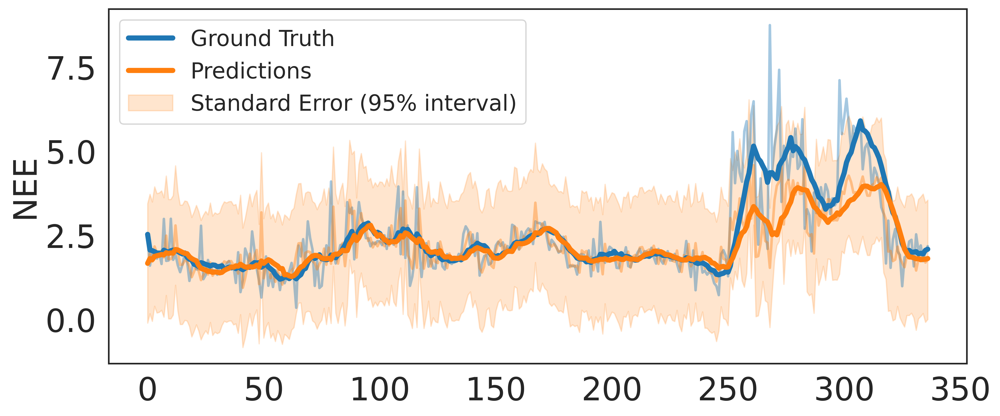

In [77]:
### Monthly

mask = (test_data.DateTime.dt.year == 2019) & (test_data.DateTime.dt.month == 1)

date1 = test_data.DateTime[mask].iloc[0]
date2 = test_data.DateTime[mask].iloc[-1]
date = str(date1).split(' ')[0] + " till " + str(date2).split(' ')[0]

gt_vis = gt_rfr[mask]
preds_vis = preds_rfr[mask].flatten()

window_size = 10
gt_vis_smoothed = pd.Series(gt_vis).rolling(window=window_size, min_periods=1).mean()
preds_vis_smoothed = pd.Series(preds_vis).rolling(window=window_size, min_periods=1).mean()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, alpha=0.4, color="#1f77b4", linewidth=2)
ax.plot(preds_vis, alpha=0.4, color="#ff7f0e", linewidth=2)
ax.plot(gt_vis_smoothed, color="#1f77b4", label="Ground Truth", linewidth=4)
ax.plot(preds_vis_smoothed, color="#ff7f0e", label="Predictions", linewidth=4)
ax.legend(fontsize='x-large')
ax.set_ylabel("NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

residuals = gt_vis - preds_vis
sigma_residual = np.std(residuals, ddof=1)  # ddof=1 for unbiased estimator
z_score = 1.96  # 95% confidence interval
lower_bound = preds_vis - z_score * sigma_residual
upper_bound = preds_vis + z_score * sigma_residual

plt.fill_between(np.arange(len(preds_vis)), lower_bound, upper_bound, color="#ff7f0e", alpha=0.2, label="Standard Error (95% interval)")
#ax.legend(["Ground Truth", "Predictions", "Standard Error (95% interval)"], fontsize='x-large')
ax.legend(fontsize='x-large')
# ax.set_title(f"RF: NEE Monthly Scale ({date})", fontsize=25)
fig.savefig("RF_monthly.png", bbox_inches='tight')

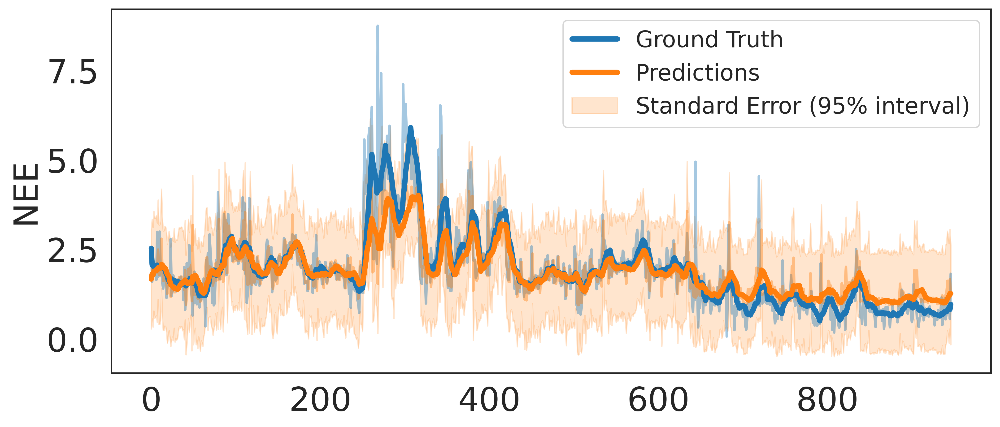

In [78]:
### Quarterly

test_data.season.unique()

mask = (test_data.DateTime.dt.year == 2019) & (test_data.season == 1)

date1 = test_data.DateTime[mask].iloc[0]
date2 = test_data.DateTime[mask].iloc[-1]
date = str(date1).split(' ')[0] + " till " + str(date2).split(' ')[0]

gt_vis = gt_rfr[mask]
preds_vis = preds_rfr[mask].flatten()

window_size = 10
gt_vis_smoothed = pd.Series(gt_vis).rolling(window=window_size, min_periods=1).mean()
preds_vis_smoothed = pd.Series(preds_vis).rolling(window=window_size, min_periods=1).mean()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, alpha=0.4, color="#1f77b4", linewidth=2)
ax.plot(preds_vis, alpha=0.4, color="#ff7f0e", linewidth=2)
ax.plot(gt_vis_smoothed, color="#1f77b4", label="Ground Truth", linewidth=4)
ax.plot(preds_vis_smoothed, color="#ff7f0e", label="Predictions", linewidth=4)
ax.legend(fontsize='x-large')
ax.set_ylabel("NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

residuals = gt_vis - preds_vis
sigma_residual = np.std(residuals, ddof=1)  # ddof=1 for unbiased estimator
z_score = 1.96  # 95% confidence interval
lower_bound = preds_vis - z_score * sigma_residual
upper_bound = preds_vis + z_score * sigma_residual

plt.fill_between(np.arange(len(preds_vis)), lower_bound, upper_bound, color="#ff7f0e", alpha=0.2, label="Standard Error (95% interval)")

ax.legend(fontsize='x-large')

# ax.set_title(f"RF: NEE Quarterly Scale ({date})", fontsize=25)
fig.savefig("RF_quarterly.png", bbox_inches='tight')

# XGB

In [79]:
seed = 0

results = DotMap({})
print(f"Experimenting for seed {seed}")
torch.manual_seed(seed)
input_rfr = np.concatenate((X_train, train_data[['NEE']].values), axis=1)  # list(range(0, 15)) + [16, 17]
rfr = XGBRegressor(n_estimators=100, random_state=seed, n_jobs=-1)
rfr.fit(input_rfr, NEE_train)
input_rfr = np.concatenate((X_test, test_data[['NEE']].values), axis=1)
preds_rfr = rfr.predict(input_rfr)
gt_rfr = NEE_test.values
mmd = compute_mmd(gt_rfr, preds_rfr)
wasstn = wasserstein_distance(gt_rfr, preds_rfr)
kl = compute_kl_divergence(gt_rfr, preds_rfr)
mae = mean_absolute_error(gt_rfr, preds_rfr)
r2 = r2_score(gt_rfr, preds_rfr)
results.mmd = mmd
results.wasstn = wasstn
results.kl = kl
results.mae = mae
results.r2 = r2
print(colored("NEE", "blue"), "\nMMD: {}, Wasstn: {}, KL: {}, MAE: {}, R2: {}".format(mmd, wasstn, kl, mae, r2))

    

Experimenting for seed 0
NEE 
MMD: 0.05674536397513051, Wasstn: 0.15329998740305173, KL: 0.21308527436889743, MAE: 0.9248766349535417, R2: 0.7057910604765774


/tmp/ipykernel_139341/559103328.py:17: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "go-" (-> color='g'). The keyword argument will take precedence.
  ax.plot(gt_vis, 'go-', color="#1f77b4", linewidth=4, markersize=8)
/tmp/ipykernel_139341/559103328.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "go-" (-> color='g'). The keyword argument will take precedence.
  ax.plot(preds_vis, 'go-', color="#ff7f0e", linewidth=4, markersize=8)


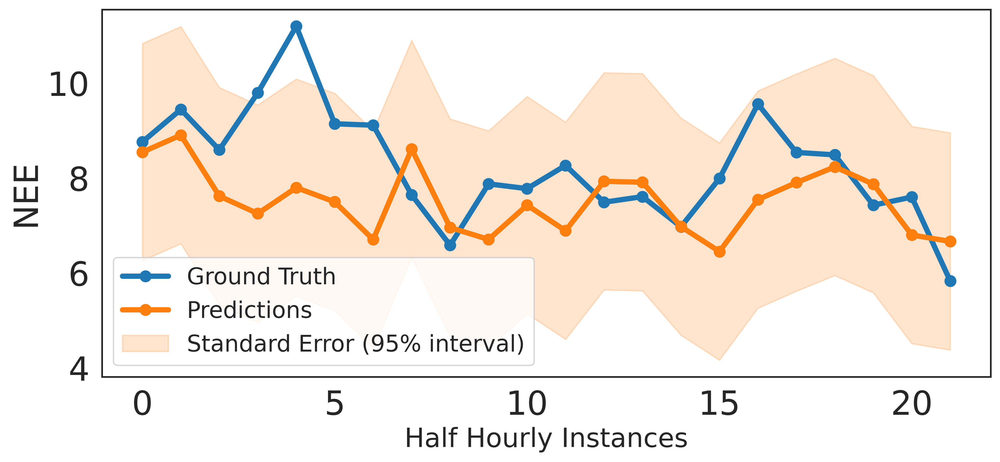

In [80]:
### Daily

test_data['time_diff'] = test_data.DateTime.diff()

test_data['daily_group'] = (test_data.time_diff > pd.Timedelta(hours=2)).cumsum()

mask = (test_data['daily_group'] == 345).values

date = test_data.DateTime[mask].iloc[0]
date = str(date).split(' ')[0]


gt_vis = gt_rfr[mask]
preds_vis = preds_rfr[mask].flatten()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, 'go-', color="#1f77b4", linewidth=4, markersize=8)
ax.plot(preds_vis, 'go-', color="#ff7f0e", linewidth=4, markersize=8)
ax.set_ylabel("NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

residuals = gt_vis - preds_vis
sigma_residual = np.std(residuals, ddof=1)  # ddof=1 for unbiased estimator
z_score = 1.96  # 95% confidence interval
lower_bound = preds_vis - z_score * sigma_residual
upper_bound = preds_vis + z_score * sigma_residual

plt.fill_between(np.arange(len(preds_vis)), lower_bound, upper_bound, color="#ff7f0e", alpha=0.2, label="Standard Error (95% interval)")
ax.legend(["Ground Truth", "Predictions", "Standard Error (95% interval)"], fontsize='x-large')

ax.set_xlabel(r"Half Hourly Instances", fontsize=20)

# ax.set_title(f"XGB: NEE Daily Scale ({date})", fontsize=25)
fig.savefig("XGB_daily.png", bbox_inches='tight')


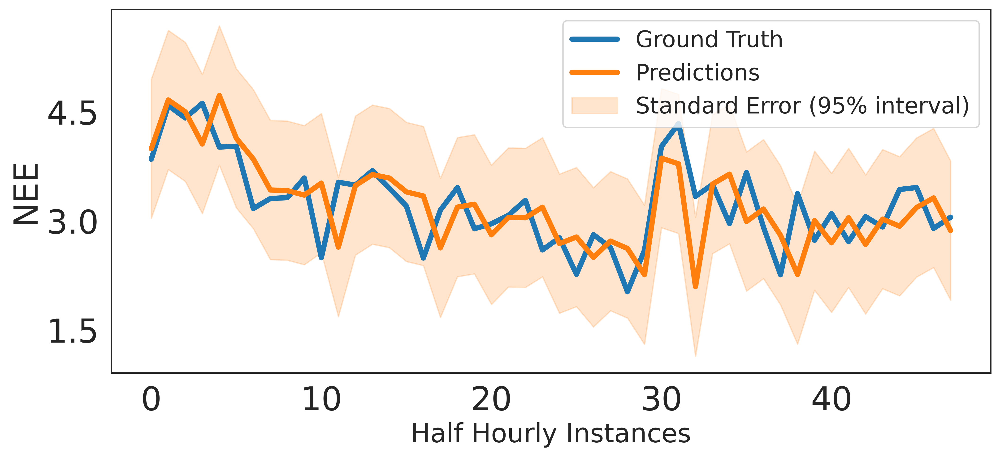

In [81]:
### Weekly

test_data['week_group'] = (test_data['dayofweek'] < test_data['dayofweek'].shift()).cumsum()

mask = test_data.week_group == 12

date1 = test_data.DateTime[mask].iloc[0]
date2 = test_data.DateTime[mask].iloc[-1]
date = str(date1).split(' ')[0] + " till " + str(date2).split(' ')[0]

gt_vis = gt_rfr[mask]
preds_vis = preds_rfr[mask].flatten()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, '-', color="#1f77b4", linewidth=4, markersize=8)
ax.plot(preds_vis, '-', color="#ff7f0e", linewidth=4, markersize=8)
ax.set_ylabel("NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

residuals = gt_vis - preds_vis
sigma_residual = np.std(residuals, ddof=1)  # ddof=1 for unbiased estimator
z_score = 1.96  # 95% confidence interval
lower_bound = preds_vis - z_score * sigma_residual
upper_bound = preds_vis + z_score * sigma_residual

plt.fill_between(np.arange(len(preds_vis)), lower_bound, upper_bound, color="#ff7f0e", alpha=0.2, label="Standard Error (95% interval)")
ax.legend(["Ground Truth", "Predictions", "Standard Error (95% interval)"], fontsize='x-large')

ax.set_xlabel(r"Half Hourly Instances", fontsize=20)

# ax.set_title(f"XGB: NEE Weekly Scale ({date})", fontsize=25)
fig.savefig("XGB_weekly.png", bbox_inches='tight')


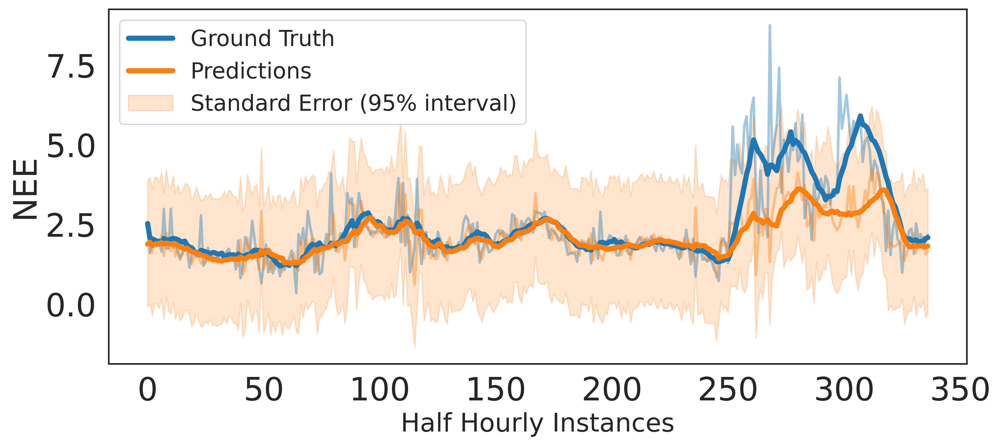

In [82]:
### Monthly

mask = (test_data.DateTime.dt.year == 2019) & (test_data.DateTime.dt.month == 1)

date1 = test_data.DateTime[mask].iloc[0]
date2 = test_data.DateTime[mask].iloc[-1]
date = str(date1).split(' ')[0] + " till " + str(date2).split(' ')[0]

gt_vis = gt_rfr[mask]
preds_vis = preds_rfr[mask].flatten()

window_size = 10
gt_vis_smoothed = pd.Series(gt_vis).rolling(window=window_size, min_periods=1).mean()
preds_vis_smoothed = pd.Series(preds_vis).rolling(window=window_size, min_periods=1).mean()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, alpha=0.4, color="#1f77b4", linewidth=2)
ax.plot(preds_vis, alpha=0.4, color="#ff7f0e", linewidth=2)
ax.plot(gt_vis_smoothed, color="#1f77b4", label="Ground Truth", linewidth=4)
ax.plot(preds_vis_smoothed, color="#ff7f0e", label="Predictions", linewidth=4)
ax.legend(fontsize='x-large')
ax.set_ylabel("NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

residuals = gt_vis - preds_vis
sigma_residual = np.std(residuals, ddof=1)  # ddof=1 for unbiased estimator
z_score = 1.96  # 95% confidence interval
lower_bound = preds_vis - z_score * sigma_residual
upper_bound = preds_vis + z_score * sigma_residual

plt.fill_between(np.arange(len(preds_vis)), lower_bound, upper_bound, color="#ff7f0e", alpha=0.2, label="Standard Error (95% interval)")
#ax.legend(["Ground Truth", "Predictions", "Standard Error (95% interval)"], fontsize='x-large')
ax.legend(fontsize='x-large')

ax.set_xlabel(r"Half Hourly Instances", fontsize=20)

# ax.set_title(f"XGB: NEE Monthly Scale ({date})", fontsize=25)
fig.savefig("XGB_monthly.png", bbox_inches='tight')

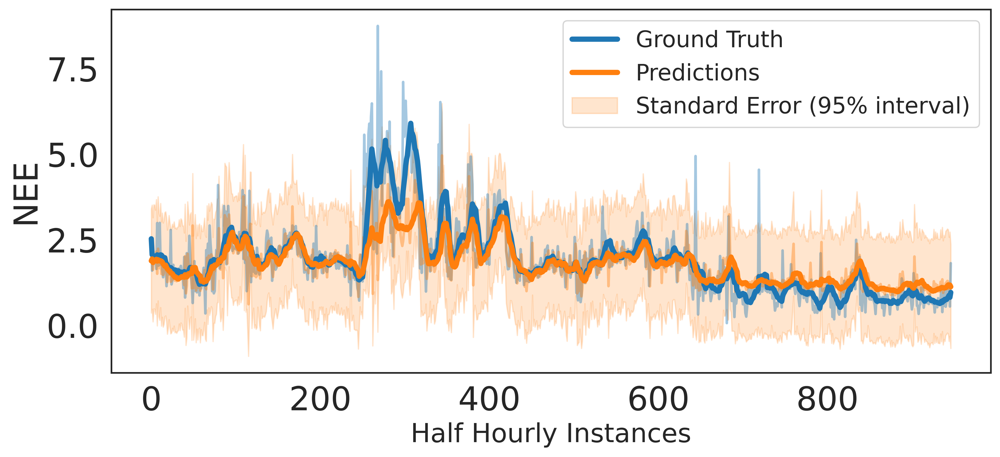

In [83]:
### Quarterly

test_data.season.unique()

mask = (test_data.DateTime.dt.year == 2019) & (test_data.season == 1)

date1 = test_data.DateTime[mask].iloc[0]
date2 = test_data.DateTime[mask].iloc[-1]
date = str(date1).split(' ')[0] + " till " + str(date2).split(' ')[0]

gt_vis = gt_rfr[mask]
preds_vis = preds_rfr[mask].flatten()

window_size = 10
gt_vis_smoothed = pd.Series(gt_vis).rolling(window=window_size, min_periods=1).mean()
preds_vis_smoothed = pd.Series(preds_vis).rolling(window=window_size, min_periods=1).mean()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, alpha=0.4, color="#1f77b4", linewidth=2)
ax.plot(preds_vis, alpha=0.4, color="#ff7f0e", linewidth=2)
ax.plot(gt_vis_smoothed, color="#1f77b4", label="Ground Truth", linewidth=4)
ax.plot(preds_vis_smoothed, color="#ff7f0e", label="Predictions", linewidth=4)
ax.legend(fontsize='x-large')
ax.set_ylabel("NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

residuals = gt_vis - preds_vis
sigma_residual = np.std(residuals, ddof=1)  # ddof=1 for unbiased estimator
z_score = 1.96  # 95% confidence interval
lower_bound = preds_vis - z_score * sigma_residual
upper_bound = preds_vis + z_score * sigma_residual

plt.fill_between(np.arange(len(preds_vis)), lower_bound, upper_bound, color="#ff7f0e", alpha=0.2, label="Standard Error (95% interval)")

ax.legend(fontsize='x-large')
ax.set_xlabel(r"Half Hourly Instances", fontsize=20)

# ax.set_title(f"XGB: NEE Quarterly Scale ({date})", fontsize=25)
fig.savefig("XGB_quarterly.png", bbox_inches='tight')

#### Standard Errors

## XGB

In [142]:
seeds = [0, 41, 123, 255, 999]
all_results_xgb = []
for seed in seeds:
    results = DotMap({})
    print(f"Experimenting for seed {seed}")
    torch.manual_seed(seed)
    input_rfr = np.concatenate((X_train, train_data[['NEE', 'E0', 'rb']].values), axis=1)  # list(range(0, 15)) + [16, 17]
    rfr = XGBRegressor(n_estimators=100, random_state=seed, n_jobs=-1)
    rfr.fit(input_rfr, NEE_train)
    input_rfr = np.concatenate((X_test, test_data[['NEE', 'E0', 'rb']].values), axis=1)
    preds_rfr = rfr.predict(input_rfr)
    gt_rfr = NEE_test.values
    mmd = compute_mmd(gt_rfr, preds_rfr)
    wasstn = wasserstein_distance(gt_rfr, preds_rfr)
    kl = compute_kl_divergence(gt_rfr, preds_rfr)
    mae = mean_absolute_error(gt_rfr, preds_rfr)
    r2 = r2_score(gt_rfr, preds_rfr)
    results.mmd = mmd
    results.wasstn = wasstn
    results.kl = kl
    results.mae = mae
    results.r2 = r2
    print(colored("NEE", "blue"), "\nMMD: {}, Wasstn: {}, KL: {}, MAE: {}, R2: {}".format(mmd, wasstn, kl, mae, r2))
    all_results_xgb.append(results)
    

Experimenting for seed 0
NEE 
MMD: 0.052352936667433, Wasstn: 0.20205098003111185, KL: 0.21689917392301125, MAE: 0.9875612285772472, R2: 0.6585242786548966
Experimenting for seed 41
NEE 
MMD: 0.052352936667433, Wasstn: 0.20205098003111185, KL: 0.21689917392301125, MAE: 0.9875612285772472, R2: 0.6585242786548966
Experimenting for seed 123
NEE 
MMD: 0.052352936667433, Wasstn: 0.20205098003111185, KL: 0.21689917392301125, MAE: 0.9875612285772472, R2: 0.6585242786548966
Experimenting for seed 255
NEE 
MMD: 0.052352936667433, Wasstn: 0.20205098003111185, KL: 0.21689917392301125, MAE: 0.9875612285772472, R2: 0.6585242786548966
Experimenting for seed 999
NEE 
MMD: 0.052352936667433, Wasstn: 0.20205098003111185, KL: 0.21689917392301125, MAE: 0.9875612285772472, R2: 0.6585242786548966


#### Standard Errors

In [143]:
metrics = ['mmd', 'wasstn', 'kl', 'mae', 'r2']
for metric in metrics:
    metric_values = [] 
    for result in all_results_xgb:
        metric_values.append(result[metric])
    std = np.std(metric_values)
    mean = np.mean(metric_values)
    std_error = std / np.sqrt(len(all_results))
    print(metric, mean, std_error)
        

mmd 0.052352936667433 0.0
wasstn 0.20205098003111183 1.2412670766236365e-17
kl 0.21689917392301122 1.2412670766236365e-17
mae 0.987561228577247 4.965068306494546e-17
r2 0.6585242786548966 0.0


## Evaluation and Analysis

/var/folders/7r/b0750y3s1vq7yqj7x8mjxc3m0000gn/T/ipykernel_12069/1948066264.py:19: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "go-" (-> color='g'). The keyword argument will take precedence.
  ax.plot(gt_vis, 'go-', color="#1f77b4", linewidth=4, markersize=8)
/var/folders/7r/b0750y3s1vq7yqj7x8mjxc3m0000gn/T/ipykernel_12069/1948066264.py:20: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "go-" (-> color='g'). The keyword argument will take precedence.
  ax.plot(preds_vis, 'go-', color="#ff7f0e", linewidth=4, markersize=8)
/var/folders/7r/b0750y3s1vq7yqj7x8mjxc3m0000gn/T/ipykernel_12069/1948066264.py:21: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "go-" (-> color='g'). The keyword argument will take precedence.
  ax.plot(preds_vis_raw, 'go-', color="green", linewidth=4, markersize=8)
/var/folders/7r/b0750y3s1vq7yqj7x8mjxc3m0000gn/T/ipykernel_120

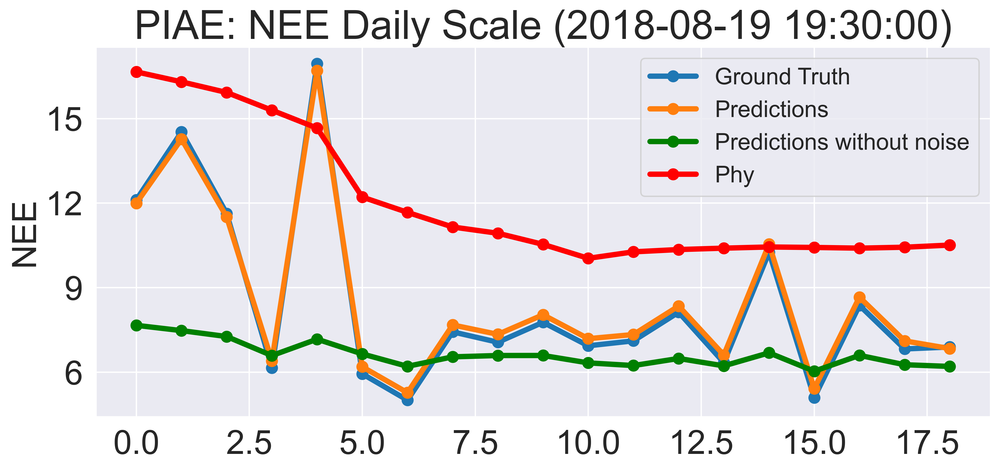

In [262]:
### Daily


test_data['time_diff'] = test_data.DateTime.diff()

test_data['daily_group'] = (test_data.time_diff > pd.Timedelta(hours=2)).cumsum()

mask = (test_data['daily_group'] == 5).values

date = test_data.DateTime[mask].iloc[0]


gt_vis = gt.nee[mask]
preds_vis = preds.nee[mask].flatten() 
preds_vis_raw = preds.nee[mask].flatten() - preds.noise[mask].flatten()
phy = test_data['NEE_phy'][mask].values.flatten() 

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, 'go-', color="#1f77b4", linewidth=4, markersize=8)
ax.plot(preds_vis, 'go-', color="#ff7f0e", linewidth=4, markersize=8)
ax.plot(preds_vis_raw, 'go-', color="green", linewidth=4, markersize=8)
ax.plot(phy, 'go-', color="red", linewidth=4, markersize=8)

# Calculate final mean prediction
mean_prediction = preds_vis_raw + 

# Calculate prediction intervals
z_score = 1.96  # For 95% confidence
lower_bound = mean_prediction - z_score * preds.noise_stds[mask]
upper_bound = mean_prediction + z_score * preds.noise_stds[mask]


plt.fill_between(np.arange(len(preds_vis)), lower_bound, upper_bound, color="#ff7f0e", alpha=0.2, label="95% Prediction Interval")


ax.legend(["Ground Truth", "Predictions", "Predictions without noise", "Phy"], fontsize='x-large')
ax.set_ylabel("NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

ax.set_title(f"PIAE: NEE Daily Scale ({date})", fontsize=30)

fig.savefig("piae_nee_night_daily.png", bbox_inches='tight')


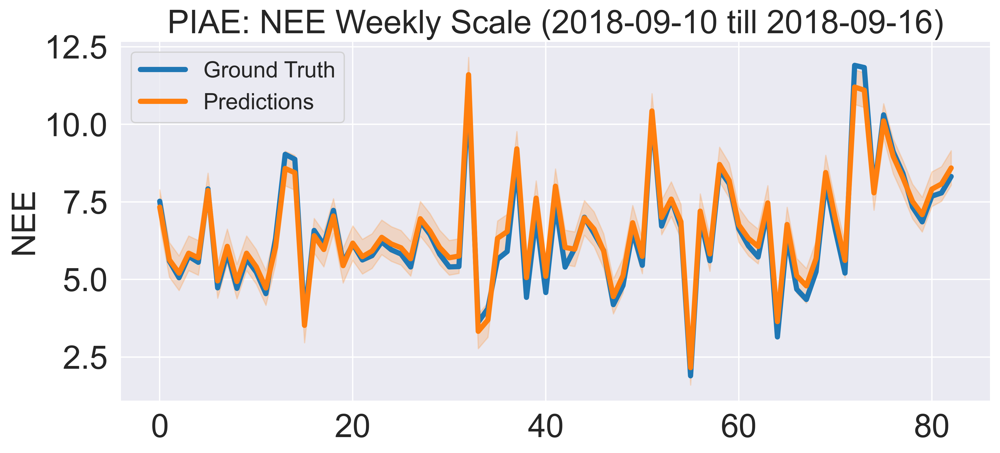

In [266]:
### Weekly

test_data['week_group'] = (test_data['dayofweek'] < test_data['dayofweek'].shift()).cumsum()

mask = test_data.week_group == 4

date1 = test_data.DateTime[mask].iloc[0]
date2 = test_data.DateTime[mask].iloc[-1]
date = str(date1).split(' ')[0] + " till " + str(date2).split(' ')[0]

gt_vis = gt.nee[mask]
preds_vis = preds.nee[mask].flatten()


fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, '-', color="#1f77b4", linewidth=4, markersize=8)
ax.plot(preds_vis, '-', color="#ff7f0e", linewidth=4, markersize=8)

residuals = gt_vis - preds_vis
sigma_residual = np.std(residuals, ddof=1)  # ddof=1 for unbiased estimator
z_score = 1.96  # 95% confidence interval
lower_bound = preds_vis - z_score * sigma_residual
upper_bound = preds_vis + z_score * sigma_residual

plt.fill_between(np.arange(len(preds_vis)), lower_bound, upper_bound, color="#ff7f0e", alpha=0.2, label="95% Prediction Interval")


ax.legend(["Ground Truth", "Predictions"], fontsize='x-large')
ax.set_ylabel("NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

ax.set_title(f"PIAE: NEE Weekly Scale ({date})", fontsize=25)
fig.savefig("piae_nee_night_weekly.png", bbox_inches='tight')


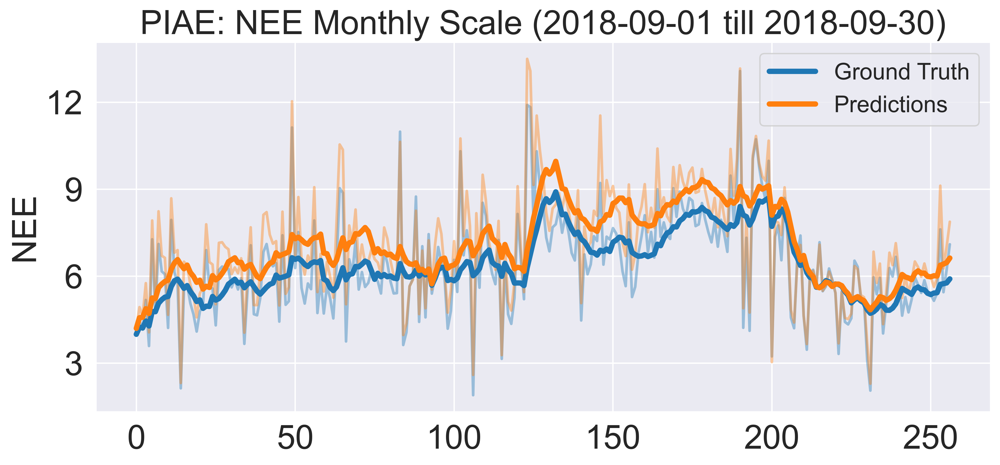

In [96]:
### Monthly

mask = (test_data.DateTime.dt.year == 2018) & (test_data.DateTime.dt.month == 9)

date1 = test_data.DateTime[mask].iloc[0]
date2 = test_data.DateTime[mask].iloc[-1]
date = str(date1).split(' ')[0] + " till " + str(date2).split(' ')[0]

gt_vis = gt.nee[mask]
preds_vis = preds.nee[mask].flatten()

window_size = 10
gt_vis_smoothed = pd.Series(gt_vis).rolling(window=window_size, min_periods=1).mean()
preds_vis_smoothed = pd.Series(preds_vis).rolling(window=window_size, min_periods=1).mean()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, alpha=0.4, color="#1f77b4", linewidth=2)
ax.plot(preds_vis, alpha=0.4, color="#ff7f0e", linewidth=2)
ax.plot(gt_vis_smoothed, color="#1f77b4", label="Ground Truth", linewidth=4)
ax.plot(preds_vis_smoothed, color="#ff7f0e", label="Predictions", linewidth=4)
ax.legend(fontsize='x-large')
ax.set_ylabel("NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

ax.set_title(f"PIAE: NEE Monthly Scale ({date})", fontsize=25)
fig.savefig("piae_nee_night_monthly.png", bbox_inches='tight')

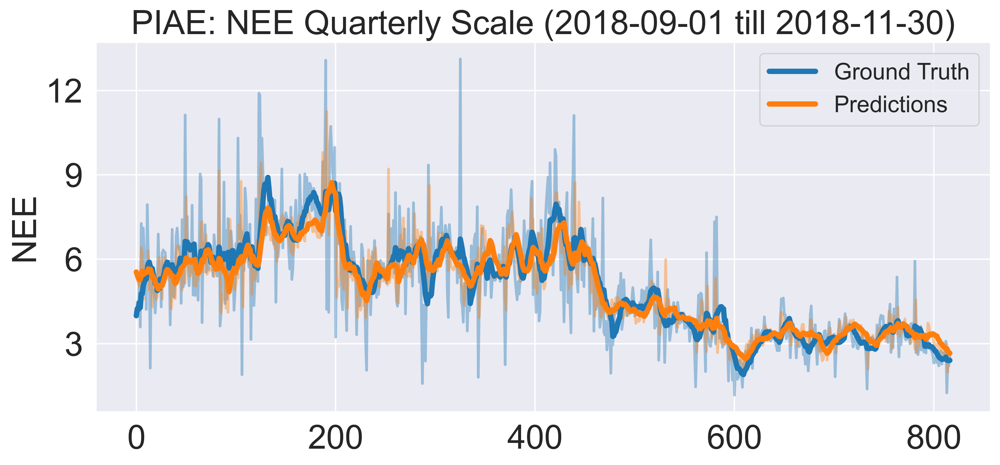

In [98]:
### Quarterly

test_data.season.unique()

mask = (test_data.DateTime.dt.year == 2018) & (test_data.season == 4)

date1 = test_data.DateTime[mask].iloc[0]
date2 = test_data.DateTime[mask].iloc[-1]
date = str(date1).split(' ')[0] + " till " + str(date2).split(' ')[0]

gt_vis = gt.nee[mask]
preds_vis = preds.nee[mask].flatten()

window_size = 10
gt_vis_smoothed = pd.Series(gt_vis).rolling(window=window_size, min_periods=1).mean()
preds_vis_smoothed = pd.Series(preds_vis).rolling(window=window_size, min_periods=1).mean()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, alpha=0.4, color="#1f77b4", linewidth=2)
ax.plot(preds_vis, alpha=0.4, color="#ff7f0e", linewidth=2)
ax.plot(gt_vis_smoothed, color="#1f77b4", label="Ground Truth", linewidth=4)
ax.plot(preds_vis_smoothed, color="#ff7f0e", label="Predictions", linewidth=4)
ax.legend(fontsize='x-large')
ax.set_ylabel("NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

ax.set_title(f"PIAE: NEE Quarterly Scale ({date})", fontsize=25)
fig.savefig("piae_nee_night_quarterly.png", bbox_inches='tight')

## Training on MMD now for noise modelling

In [67]:
best_test_loss = float('inf')
best_model_path = save_dir.joinpath('best_model.pth')

In [68]:
epoch = 0

##### Control Room

In [69]:
# CONTROL ROOM
loss_fn = MMD_loss()
for g in optimizer.param_groups:
    g['lr'] = 0.001

##### Back to training

In [71]:
model.eval()

PIAE_SDE(
  (encoder): Sequential(
    (0): Linear(in_features=18, out_features=16, bias=True)
    (1): ReLU()
    (2): Linear(in_features=16, out_features=16, bias=True)
    (3): Linear(in_features=16, out_features=32, bias=True)
  )
  (nee_decoder): Sequential(
    (0): Linear(in_features=32, out_features=16, bias=True)
    (1): ReLU()
    (2): Linear(in_features=16, out_features=16, bias=True)
    (3): Linear(in_features=16, out_features=1, bias=True)
  )
  (temp_derivative_decoder): Sequential(
    (0): Linear(in_features=32, out_features=16, bias=True)
    (1): ReLU()
    (2): Linear(in_features=16, out_features=16, bias=True)
    (3): Linear(in_features=16, out_features=1, bias=True)
  )
  (k_decoder): Sequential(
    (0): Linear(in_features=32, out_features=16, bias=True)
    (1): ReLU()
    (2): Linear(in_features=16, out_features=16, bias=True)
    (3): Linear(in_features=16, out_features=2, bias=True)
    (4): ReLU()
  )
)

In [72]:
preds = DotMap({"nee": [], "E0": [], "rb": [] , "dtemp": [] , "f": [], "z": []})
gt = DotMap({"nee": [], "E0": [], "rb": [] , "dtemp": [] , "f": []})


for batch in test_data_loader:
    x = batch['X'].to(device)
    k = batch['k'].to(device)
    f = batch['dNEE'].to(device)
    b = batch['bNEE'].to(device)
    dtemp = batch['dT'].to(device)
    nee = batch['NEE'].to(device)
            
    nee_pred, dT_dt_pred, k_pred, f_pred, z, residual = model(x)
    E0_pred, rb_pred = k_pred[:, 0], k_pred[:, 1]
    
    preds.nee.extend(nee_pred.cpu().detach().numpy().tolist())
    preds.E0.extend(E0_pred.cpu().detach().numpy().tolist())
    preds.rb.extend(rb_pred.cpu().detach().numpy().tolist())
    preds.dtemp.extend(dT_dt_pred.cpu().detach().numpy().flatten().tolist())
    preds.f.extend(f_pred.cpu().detach().numpy().tolist())
    preds.z.extend(z.cpu().detach().numpy().tolist())
    
    gt.nee.extend(nee.cpu().detach().numpy().tolist())
    gt.E0.extend(k[:, 0].cpu().detach().numpy().tolist())
    gt.rb.extend(k[:, 1].cpu().detach().numpy().tolist())
    gt.f.extend(f.cpu().detach().numpy().tolist())
    gt.dtemp.extend(dtemp.cpu().detach().numpy().tolist())

for col in preds:
    preds[col] = np.array(preds[col])
    if len(preds[col].shape) > 1 and preds[col].shape[1] == 1:
        preds[col] = preds[col].flatten()
for col in gt:
    gt[col] = np.array(gt[col])
    if len(gt[col].shape) > 1 and gt[col].shape[1] == 1:
        gt[col] = gt[col].flatten()

In [73]:
print(colored("Metrics ", "red"))
for col in gt:
    
    mmd = compute_mmd(gt[col], preds[col])
    wasstn = wasserstein_distance(gt[col], preds[col])
    kl = compute_kl_divergence(gt[col], preds[col])
    mae = mean_absolute_error(gt[col], preds[col])
    r2 = r2_score(gt[col], preds[col])
    print(colored(col, "blue"), "\nMMD: {}, Wasstn: {}, KL: {}, MAE: {}, R2: {}".format(mmd, wasstn, kl, mae, r2))
    config.eval.mae[col] = mean_absolute_error(gt[col], preds[col])
    config.eval.r2[col] = r2_score(gt[col], preds[col])

with open(save_dir.joinpath("config.json"), "w") as fp:
    json.dump(config.toDict(), fp)

Metrics 
nee 
MMD: 0.04964816990187348, Wasstn: 0.13031518517728063, KL: 0.13335490986327686, MAE: 1.1115466750887566, R2: 0.574903199875495
E0 
MMD: 0.11021267201432779, Wasstn: 0.822791964784407, KL: 0.6077282486963288, MAE: 1.114507809195874, R2: 0.9975573571307922
rb 
MMD: 0.03777672466706936, Wasstn: 0.13905951634305838, KL: 0.6188039342107797, MAE: 0.2571809713231902, R2: 0.9792450210936386
dtemp 
MMD: 0.06941862133982124, Wasstn: 0.10504106700523719, KL: 2.475527204846719, MAE: 0.11218209476813679, R2: -929.5103831651008
f 
MMD: 0.0022951418296154025, Wasstn: 0.016919591604178393, KL: 0.7659079913367797, MAE: 0.03585930135793659, R2: -0.2379537721415972


/var/folders/7r/b0750y3s1vq7yqj7x8mjxc3m0000gn/T/ipykernel_21486/1391182150.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "go-" (-> color='g'). The keyword argument will take precedence.
  ax.plot(gt_vis, 'go-', color="#1f77b4", linewidth=4, markersize=8)
/var/folders/7r/b0750y3s1vq7yqj7x8mjxc3m0000gn/T/ipykernel_21486/1391182150.py:19: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "go-" (-> color='g'). The keyword argument will take precedence.
  ax.plot(preds_vis, 'go-', color="#ff7f0e", linewidth=4, markersize=8)


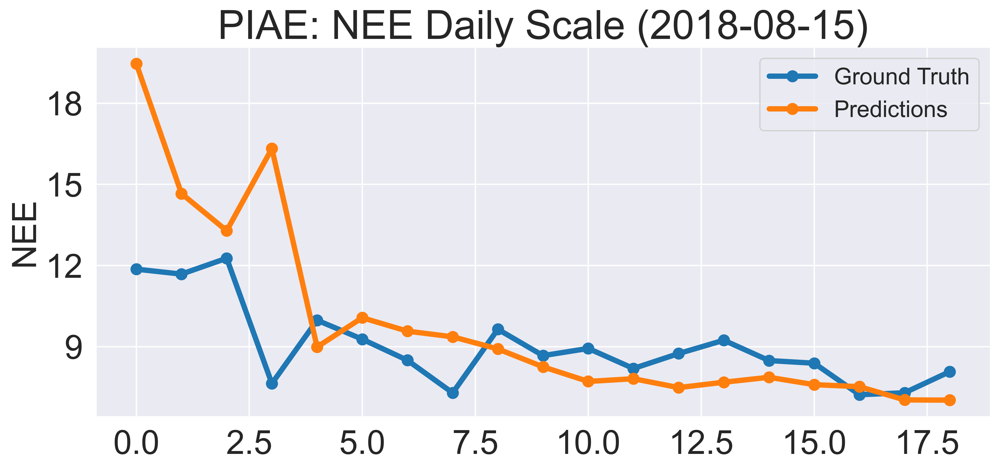

In [133]:
### Daily


test_data['time_diff'] = test_data.DateTime.diff()

test_data['daily_group'] = (test_data.time_diff > pd.Timedelta(hours=2)).cumsum()

mask = (test_data['daily_group'] == 1).values

date = test_data.DateTime[mask].iloc[0]
date = str(date).split(' ')[0]


gt_vis = gt.nee[mask]
preds_vis = preds.nee[mask].flatten()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, 'go-', color="#1f77b4", linewidth=4, markersize=8)
ax.plot(preds_vis, 'go-', color="#ff7f0e", linewidth=4, markersize=8)
ax.legend(["Ground Truth", "Predictions"], fontsize='x-large')
ax.set_ylabel("NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

ax.set_title(f"PIAE: NEE Daily Scale ({date})", fontsize=30)

fig.savefig("piae_nee_night_daily.png", bbox_inches='tight')


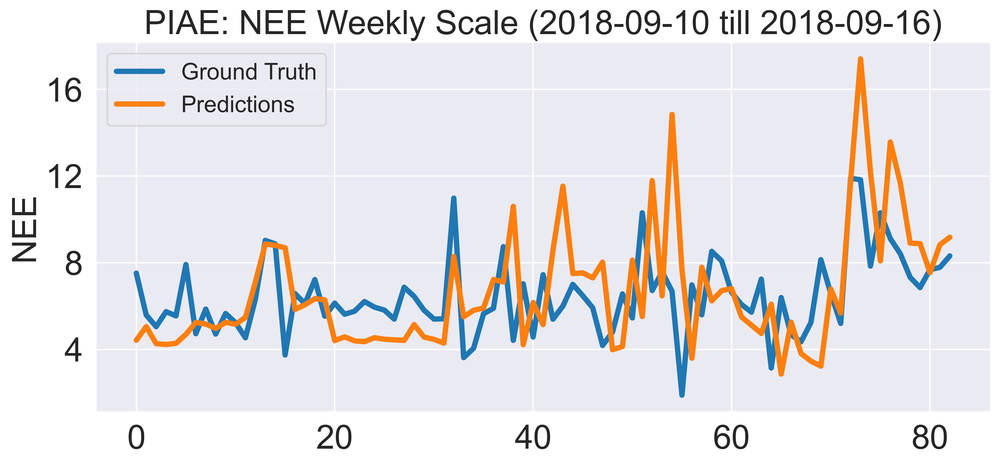

In [134]:
### Weekly

test_data['week_group'] = (test_data['dayofweek'] < test_data['dayofweek'].shift()).cumsum()

mask = test_data.week_group == 4

date1 = test_data.DateTime[mask].iloc[0]
date2 = test_data.DateTime[mask].iloc[-1]
date = str(date1).split(' ')[0] + " till " + str(date2).split(' ')[0]

gt_vis = gt.nee[mask]
preds_vis = preds.nee[mask].flatten()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, '-', color="#1f77b4", linewidth=4, markersize=8)
ax.plot(preds_vis, '-', color="#ff7f0e", linewidth=4, markersize=8)
ax.legend(["Ground Truth", "Predictions"], fontsize='x-large')
ax.set_ylabel("NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

ax.set_title(f"PIAE: NEE Weekly Scale ({date})", fontsize=25)
fig.savefig("piae_nee_night_weekly.png", bbox_inches='tight')


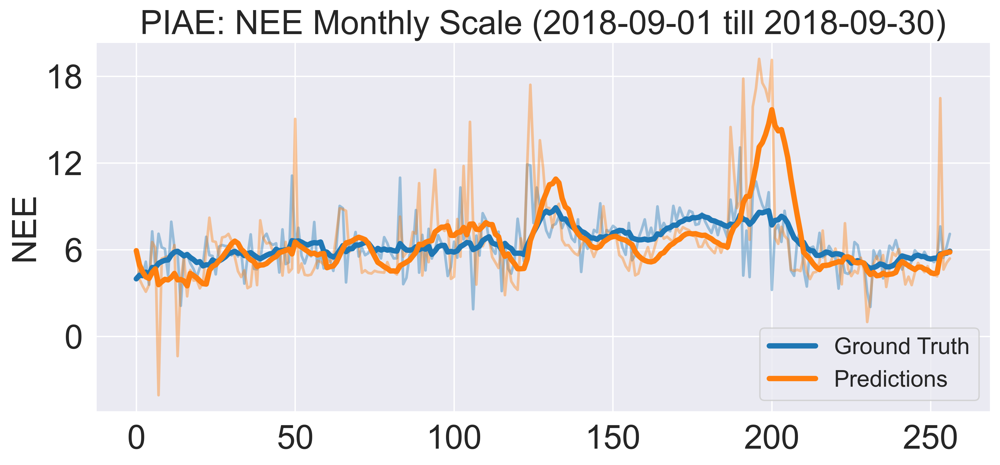

In [135]:
### Monthly

mask = (test_data.DateTime.dt.year == 2018) & (test_data.DateTime.dt.month == 9)

date1 = test_data.DateTime[mask].iloc[0]
date2 = test_data.DateTime[mask].iloc[-1]
date = str(date1).split(' ')[0] + " till " + str(date2).split(' ')[0]

gt_vis = gt.nee[mask]
preds_vis = preds.nee[mask].flatten()

window_size = 10
gt_vis_smoothed = pd.Series(gt_vis).rolling(window=window_size, min_periods=1).mean()
preds_vis_smoothed = pd.Series(preds_vis).rolling(window=window_size, min_periods=1).mean()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, alpha=0.4, color="#1f77b4", linewidth=2)
ax.plot(preds_vis, alpha=0.4, color="#ff7f0e", linewidth=2)
ax.plot(gt_vis_smoothed, color="#1f77b4", label="Ground Truth", linewidth=4)
ax.plot(preds_vis_smoothed, color="#ff7f0e", label="Predictions", linewidth=4)
ax.legend(fontsize='x-large')
ax.set_ylabel("NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

ax.set_title(f"PIAE: NEE Monthly Scale ({date})", fontsize=25)
fig.savefig("piae_nee_night_monthly.png", bbox_inches='tight')

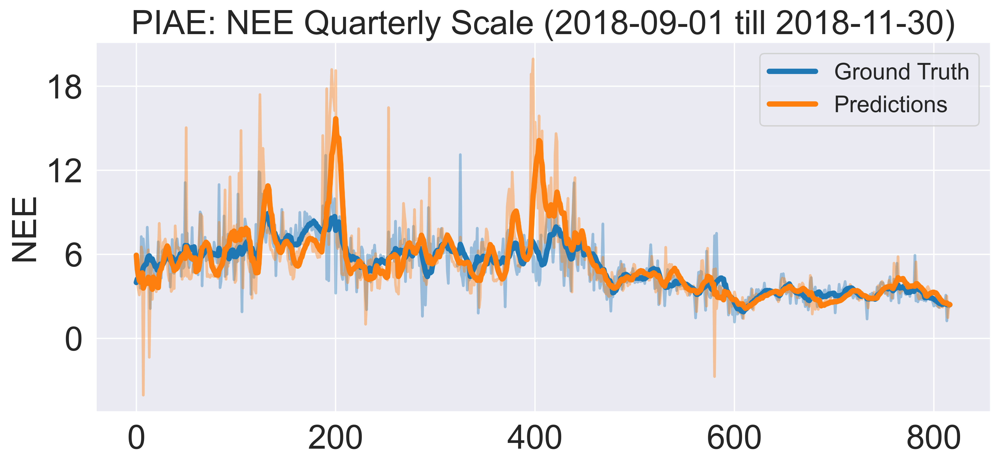

In [136]:
### Quarterly

test_data.season.unique()

mask = (test_data.DateTime.dt.year == 2018) & (test_data.season == 4)

date1 = test_data.DateTime[mask].iloc[0]
date2 = test_data.DateTime[mask].iloc[-1]
date = str(date1).split(' ')[0] + " till " + str(date2).split(' ')[0]

gt_vis = gt.nee[mask]
preds_vis = preds.nee[mask].flatten()

window_size = 10
gt_vis_smoothed = pd.Series(gt_vis).rolling(window=window_size, min_periods=1).mean()
preds_vis_smoothed = pd.Series(preds_vis).rolling(window=window_size, min_periods=1).mean()

fig, ax = plt.subplots(figsize=(12, 5), dpi=400)
ax.plot(gt_vis, alpha=0.4, color="#1f77b4", linewidth=2)
ax.plot(preds_vis, alpha=0.4, color="#ff7f0e", linewidth=2)
ax.plot(gt_vis_smoothed, color="#1f77b4", label="Ground Truth", linewidth=4)
ax.plot(preds_vis_smoothed, color="#ff7f0e", label="Predictions", linewidth=4)
ax.legend(fontsize='x-large')
ax.set_ylabel("NEE", fontsize=25)
ax.yaxis.set_major_locator(MaxNLocator(nbins=5))
ax.tick_params(axis='both', which='major', labelsize=25)

ax.set_title(f"PIAE: NEE Quarterly Scale ({date})", fontsize=25)
fig.savefig("piae_nee_night_quarterly.png", bbox_inches='tight')

In [150]:
rfr

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=100, n_jobs=-1,
             num_parallel_tree=None, random_state=0, ...)